In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from DataTransformation import LowPassFilter, PrincipalComponentAnalysis
from TemporalAbstraction import NumericalAbstraction
#from FrequencyAbstraction import FourierTransformation

# --------------------------------------------------------------
# Load data
# --------------------------------------------------------------
df = pd.read_pickle("../../data/interim/02_outliers_removed_chauvenet.pkl")

AttributeError: partially initialized module 'pandas' has no attribute 'core' (most likely due to a circular import)

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from DataTransformation import LowPassFilter, PrincipalComponentAnalysis
from TemporalAbstraction import NumericalAbstraction
#from FrequencyAbstraction import FourierTransformation

AttributeError: partially initialized module 'pandas' has no attribute 'core' (most likely due to a circular import)

Restarted tracking-barbell-exercises_2 (Python 3.8.20)

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from DataTransformation import LowPassFilter, PrincipalComponentAnalysis
from TemporalAbstraction import NumericalAbstraction
#from FrequencyAbstraction import FourierTransformation

In [2]:
df = pd.read_pickle("../../data/interim/02_outliers_removed_chauvenet.pkl")

In [3]:
# --------------------------------------------------------------

In [4]:
df

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set
epoch (ms),,,,,,,,,,
2019-01-11 15:08:05.200,0.013500,0.977000,-0.071000,-1.8904,2.4392,0.9388,B,bench,heavy,30
2019-01-11 15:08:05.400,-0.001500,0.970500,-0.079500,-1.6826,-0.8904,2.1708,B,bench,heavy,30
2019-01-11 15:08:05.600,0.001333,0.971667,-0.064333,2.5608,-0.2560,-1.4146,B,bench,heavy,30
2019-01-11 15:08:05.800,-0.024000,0.957000,-0.073500,8.0610,-4.5244,-2.0730,B,bench,heavy,30
2019-01-11 15:08:06.000,-0.028000,0.957667,-0.115000,2.4390,-1.5486,-3.6098,B,bench,heavy,30
...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.048000,-1.041500,-0.076500,1.4146,-5.6218,0.2926,E,row,medium,90
2019-01-20 17:33:27.200,-0.037000,-1.030333,-0.053333,-2.7684,-0.5854,2.2440,E,row,medium,90
2019-01-20 17:33:27.400,-0.060000,-1.031000,-0.082000,2.8416,-5.1342,-0.1220,E,row,medium,90


In [5]:
predictors_column = list(df.columns[:6])

In [6]:
plt.style.use("fivethirtyeight")
plt.rcParams["figure.figsize"] = (20,5)
plt.rcParams["figure.dpi"] = 100
plt.rcParams["lines.linewidth"] = 2

In [7]:
for col in predictors_column:
    df[col] = df[col].interpolate()

df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 9009 entries, 2019-01-11 15:08:05.200000 to 2019-01-20 17:33:27.800000
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   acc_x        9009 non-null   float64
 1   acc_y        9009 non-null   float64
 2   acc_z        9009 non-null   float64
 3   gyr_x        9009 non-null   float64
 4   gyr_y        9009 non-null   float64
 5   gyr_z        9009 non-null   float64
 6   participant  9009 non-null   object 
 7   label        9009 non-null   object 
 8   category     9009 non-null   object 
 9   set          9009 non-null   int32  
dtypes: float64(6), int32(1), object(3)
memory usage: 739.0+ KB


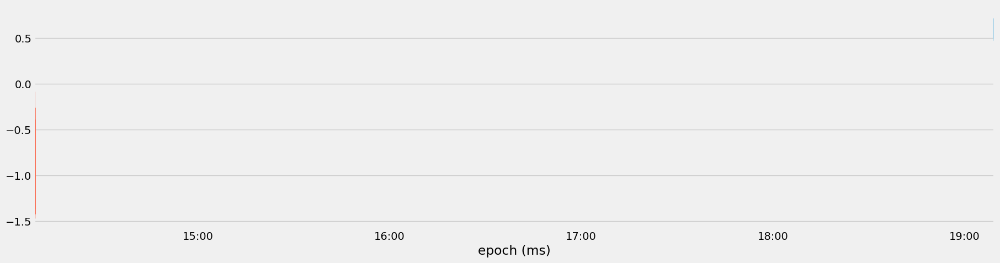

In [8]:
df[df["set"] == 25]["acc_y"].plot()
df[df["set"] == 50]["acc_y"].plot()

df[df["set"] == 1]
duration = df[df["set"] == 1].index[-1] - df[df["set"] == 1].index[0]

In [9]:
duration.seconds

16

In [10]:
for s in df["set"].unique():
    start = df[df["set"] == s].index[0]
    end =  df[df["set"] == s].index[-1]
    
    duration = end - start
    
    df.loc[(df["set"] == s) , "duration"] = duration.seconds


duration_df = df.groupby(["category"])["duration"].mean()

duration_df.iloc[0] / 5
duration_df.iloc[1] / 10

2.4942528735632186

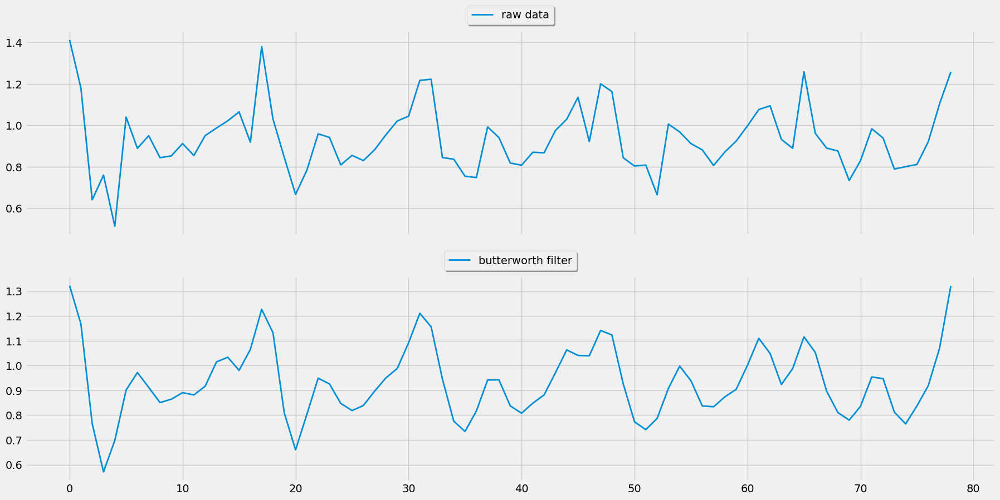

In [11]:
df_lowpass = df.copy()

LowPass= LowPassFilter()

fs = 1000/200

cutoff = 1.5

df_lowpass = LowPass.low_pass_filter( df_lowpass , "acc_y" , fs , cutoff , order=5)


subset = df_lowpass[df_lowpass["set"]==45]

#print(subset["label"][0])


fig,ax = plt.subplots(nrows=2, sharex= True , figsize = (20,10))

ax[0].plot(subset["acc_y"].reset_index(drop=True), label = "raw data")
ax[1].plot(subset["acc_y_lowpass"].reset_index(drop=True), label = "butterworth filter")
ax[0].legend(loc = "upper center"  , bbox_to_anchor = (0.5,1.15) , fancybox= True , shadow = True)
ax[1].legend(loc = "upper center"  , bbox_to_anchor = (0.5,1.15) , fancybox= True , shadow = True)

for col in predictors_column:
    df_lowpass = LowPass.low_pass_filter(df_lowpass,col,fs,cutoff,order=5)
    df_lowpass[col] = df_lowpass[col + "_lowpass"]
    del df_lowpass[col + "_lowpass"]

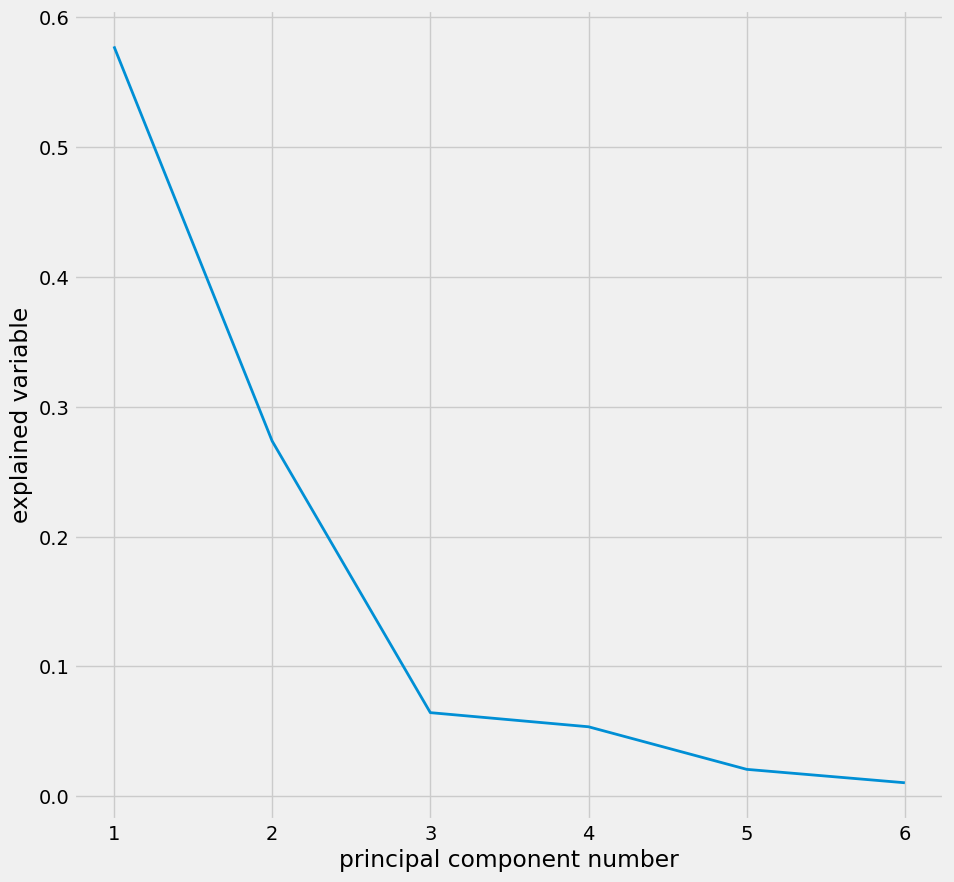

<AxesSubplot: xlabel='epoch (ms)'>

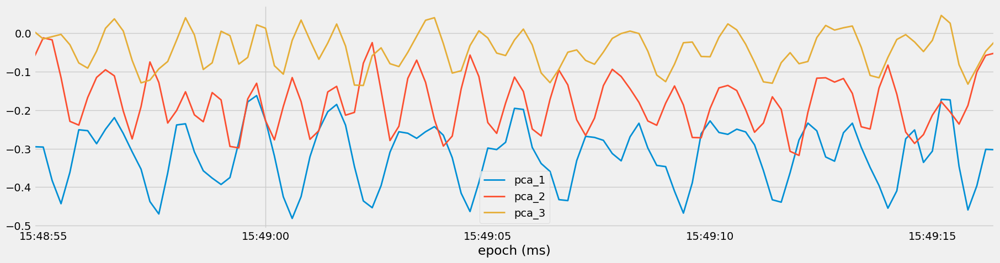

In [12]:
df_pca = df_lowpass.copy()
PCA = PrincipalComponentAnalysis()


pc_values = PCA.determine_pc_explained_variance(df_pca,predictors_column)


plt.figure(figsize=(10,10))
plt.plot(range(1, len(predictors_column)+1) , pc_values)
plt.xlabel("principal component number")
plt.ylabel("explained variable")
plt.show()

# elbow on 3  i.e 3 variables captures most info and adding more wont affect much
df_pca = PCA.apply_pca(df_pca, predictors_column , 3)


subset = df_pca[df_pca["set"]==35]

subset[["pca_1","pca_2","pca_3"]].plot()

array([<AxesSubplot: xlabel='epoch (ms)'>,
       <AxesSubplot: xlabel='epoch (ms)'>], dtype=object)

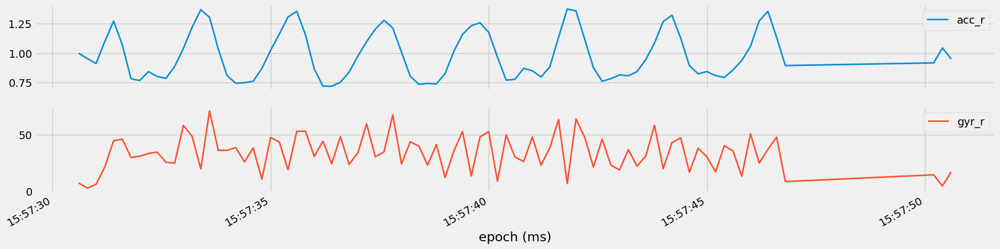

In [13]:
df_squared = df_pca.copy()

acc_r =  df_squared["acc_x"]**2 +  df_squared["acc_y"]**2 +  df_squared["acc_z"]**2
gyr_r =  df_squared["gyr_x"]**2 +  df_squared["gyr_y"]**2 +  df_squared["gyr_z"]**2

df_squared["acc_r"]  =  np.sqrt(acc_r)
df_squared["gyr_r"]  =  np.sqrt(gyr_r)

subset = df_squared[df_squared["set"] == 16]

subset[["acc_r","gyr_r"]].plot(subplots = True)

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 9009 entries, 2019-01-11 15:08:05.200000 to 2019-01-20 17:33:27.800000
Data columns (total 32 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   acc_x                 9009 non-null   float64
 1   acc_y                 9009 non-null   float64
 2   acc_z                 9009 non-null   float64
 3   gyr_x                 9009 non-null   float64
 4   gyr_y                 9009 non-null   float64
 5   gyr_z                 9009 non-null   float64
 6   participant           9009 non-null   object 
 7   label                 9009 non-null   object 
 8   category              9009 non-null   object 
 9   set                   9009 non-null   int32  
 10  duration              9009 non-null   float64
 11  pca_1                 9009 non-null   float64
 12  pca_2                 9009 non-null   float64
 13  pca_3                 9009 non-null   float64
 14  acc_r                 

<AxesSubplot: xlabel='epoch (ms)'>

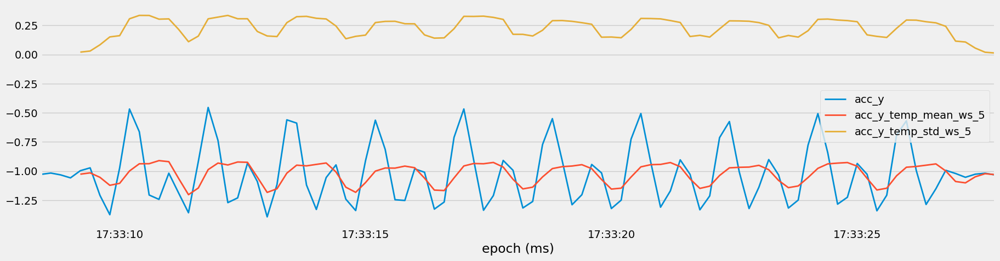

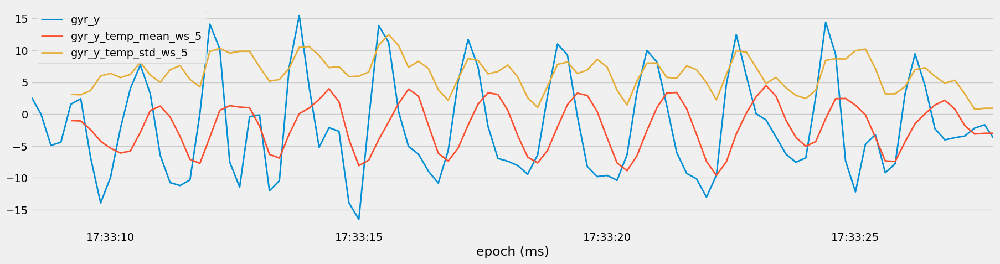

In [14]:
df_temporal = df_squared.copy()

NumAbs = NumericalAbstraction()

predictors_column = predictors_column +  ["acc_r", "gyr_r"]

ws = int(1000/200)   # window size is 1 sec so we take the value and 4 previous observation according to 200ms step size

for col in predictors_column:
    df_temporal = NumAbs.abstract_numerical(df_temporal,[col],ws,"mean")
    df_temporal = NumAbs.abstract_numerical(df_temporal,[col],ws,"std")
    

df_temporal_list = []
for s in df_temporal["set"].unique():
    subset = df_temporal[df_temporal["set"]==s].copy()
    for col in predictors_column:
        subset= NumAbs.abstract_numerical(subset,[col],ws,"mean")
        subset = NumAbs.abstract_numerical(subset,[col],ws,"std")
    df_temporal_list.append(subset)   

df_temporal = pd.concat(df_temporal_list)


df_temporal.info()
        
subset[["acc_y","acc_y_temp_mean_ws_5"	,"acc_y_temp_std_ws_5"]].plot()
subset[["gyr_y","gyr_y_temp_mean_ws_5"	,"gyr_y_temp_std_ws_5"]].plot()

In [15]:
df_temporal

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set,...,gyr_x_temp_mean_ws_5,gyr_x_temp_std_ws_5,gyr_y_temp_mean_ws_5,gyr_y_temp_std_ws_5,gyr_z_temp_mean_ws_5,gyr_z_temp_std_ws_5,acc_r_temp_mean_ws_5,acc_r_temp_std_ws_5,gyr_r_temp_mean_ws_5,gyr_r_temp_std_ws_5
epoch (ms),,,,,,,,,,,,,,,,,,,,,
2019-01-11 15:08:05.200,0.013493,0.977002,-0.070997,-1.887895,2.437925,0.935787,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-11 15:08:05.400,0.006105,0.967666,-0.071514,-3.032337,0.694192,2.296315,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-11 15:08:05.600,-0.005643,0.965015,-0.068290,4.258262,-2.166244,-1.439373,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-11 15:08:05.800,-0.023539,0.973783,-0.081724,7.675722,-3.744028,-2.916360,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-11 15:08:06.000,-0.026359,0.957652,-0.102330,0.739121,-0.907000,-1.252896,B,bench,heavy,30,...,1.550574,3.958121,-0.737031,2.156029,-0.475305,1.852883,0.971679,0.006081,4.563441,2.469165
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.035874,-1.021074,-0.061396,0.397662,-3.696725,0.301389,E,row,medium,90,...,-12.289135,18.475973,0.788916,5.325155,7.003910,6.369878,1.094008,0.113224,18.986424,15.827504
2019-01-20 17:33:27.200,-0.045205,-1.053529,-0.069579,-2.029534,-3.436981,2.216206,E,row,medium,90,...,-4.687757,12.273959,-1.790578,3.199361,4.648477,5.462710,1.104791,0.106393,11.208761,10.577354
2019-01-20 17:33:27.400,-0.052301,-1.026996,-0.067069,0.974406,-2.187979,0.946894,E,row,medium,90,...,1.164945,3.376869,-3.127729,0.755541,1.950789,2.479417,1.053305,0.055345,5.308627,2.210302


In [16]:
df_freq = df_temporal.copy().reset_index()

In [17]:
df_freq

,epoch (ms),acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,...,gyr_x_temp_mean_ws_5,gyr_x_temp_std_ws_5,gyr_y_temp_mean_ws_5,gyr_y_temp_std_ws_5,gyr_z_temp_mean_ws_5,gyr_z_temp_std_ws_5,acc_r_temp_mean_ws_5,acc_r_temp_std_ws_5,gyr_r_temp_mean_ws_5,gyr_r_temp_std_ws_5
0,2019-01-11 15:08:05.200,0.013493,0.977002,-0.070997,-1.887895,2.437925,0.935787,B,bench,heavy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2019-01-11 15:08:05.400,0.006105,0.967666,-0.071514,-3.032337,0.694192,2.296315,B,bench,heavy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2019-01-11 15:08:05.600,-0.005643,0.965015,-0.068290,4.258262,-2.166244,-1.439373,B,bench,heavy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2019-01-11 15:08:05.800,-0.023539,0.973783,-0.081724,7.675722,-3.744028,-2.916360,B,bench,heavy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2019-01-11 15:08:06.000,-0.026359,0.957652,-0.102330,0.739121,-0.907000,-1.252896,B,bench,heavy,...,1.550574,3.958121,-0.737031,2.156029,-0.475305,1.852883,0.971679,0.006081,4.563441,2.469165
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9004,2019-01-20 17:33:27.000,-0.035874,-1.021074,-0.061396,0.397662,-3.696725,0.301389,E,row,medium,...,-12.289135,18.475973,0.788916,5.325155,7.003910,6.369878,1.094008,0.113224,18.986424,15.827504
9005,2019-01-20 17:33:27.200,-0.045205,-1.053529,-0.069579,-2.029534,-3.436981,2.216206,E,row,medium,...,-4.687757,12.273959,-1.790578,3.199361,4.648477,5.462710,1.104791,0.106393,11.208761,10.577354
9006,2019-01-20 17:33:27.400,-0.052301,-1.026996,-0.067069,0.974406,-2.187979,0.946894,E,row,medium,...,1.164945,3.376869,-3.127729,0.755541,1.950789,2.479417,1.053305,0.055345,5.308627,2.210302
9007,2019-01-20 17:33:27.600,-0.044695,-1.018689,-0.054574,1.682311,-1.665131,-0.070796,E,row,medium,...,1.719971,3.182644,-3.005116,0.916137,0.613598,0.908581,1.026029,0.018830,4.365985,2.257818


In [18]:
FreqAbs = FourierTransformation()

NameError: name 'FourierTransformation' is not defined

In [19]:
from FrequencyAbstraction import FourierTransformation

In [20]:
FreqAbs = FourierTransformation()

In [21]:
fs = int(1000/200)
ws = int(2000/200)

In [22]:
df_freq = FreqAbs.abstract_frequency(df_freq,["acc_y"],ws,fs)

In [23]:
df_freq.columns

Index(['epoch (ms)', 'acc_x', 'acc_y', 'acc_z', 'gyr_x', 'gyr_y', 'gyr_z',
       'participant', 'label', 'category', 'set', 'duration', 'pca_1', 'pca_2',
       'pca_3', 'acc_r', 'gyr_r', 'acc_x_temp_mean_ws_5',
       'acc_x_temp_std_ws_5', 'acc_y_temp_mean_ws_5', 'acc_y_temp_std_ws_5',
       'acc_z_temp_mean_ws_5', 'acc_z_temp_std_ws_5', 'gyr_x_temp_mean_ws_5',
       'gyr_x_temp_std_ws_5', 'gyr_y_temp_mean_ws_5', 'gyr_y_temp_std_ws_5',
       'gyr_z_temp_mean_ws_5', 'gyr_z_temp_std_ws_5', 'acc_r_temp_mean_ws_5',
       'acc_r_temp_std_ws_5', 'gyr_r_temp_mean_ws_5', 'gyr_r_temp_std_ws_5',
       'acc_y_max_freq', 'acc_y_freq_weighted', 'acc_y_pse',
       'acc_y_freq_0.0_Hz_ws_10', 'acc_y_freq_0.5_Hz_ws_10',
       'acc_y_freq_1.0_Hz_ws_10', 'acc_y_freq_1.5_Hz_ws_10',
       'acc_y_freq_2.0_Hz_ws_10', 'acc_y_freq_2.5_Hz_ws_10'],
      dtype='object')

In [24]:
df_freq = df_temporal.copy().reset_index()

FreqAbs = FourierTransformation()

fs = int(1000/200)
ws = int(2800/200)

 
df_freq = FreqAbs.abstract_frequency(df_freq,["acc_y"],ws,fs)

df_freq.columns

Index(['epoch (ms)', 'acc_x', 'acc_y', 'acc_z', 'gyr_x', 'gyr_y', 'gyr_z',
       'participant', 'label', 'category', 'set', 'duration', 'pca_1', 'pca_2',
       'pca_3', 'acc_r', 'gyr_r', 'acc_x_temp_mean_ws_5',
       'acc_x_temp_std_ws_5', 'acc_y_temp_mean_ws_5', 'acc_y_temp_std_ws_5',
       'acc_z_temp_mean_ws_5', 'acc_z_temp_std_ws_5', 'gyr_x_temp_mean_ws_5',
       'gyr_x_temp_std_ws_5', 'gyr_y_temp_mean_ws_5', 'gyr_y_temp_std_ws_5',
       'gyr_z_temp_mean_ws_5', 'gyr_z_temp_std_ws_5', 'acc_r_temp_mean_ws_5',
       'acc_r_temp_std_ws_5', 'gyr_r_temp_mean_ws_5', 'gyr_r_temp_std_ws_5',
       'acc_y_max_freq', 'acc_y_freq_weighted', 'acc_y_pse',
       'acc_y_freq_0.0_Hz_ws_14', 'acc_y_freq_0.357_Hz_ws_14',
       'acc_y_freq_0.714_Hz_ws_14', 'acc_y_freq_1.071_Hz_ws_14',
       'acc_y_freq_1.429_Hz_ws_14', 'acc_y_freq_1.786_Hz_ws_14',
       'acc_y_freq_2.143_Hz_ws_14', 'acc_y_freq_2.5_Hz_ws_14'],
      dtype='object')

In [25]:
subset = df_freq[df_freq["set"]==15]

<AxesSubplot: >

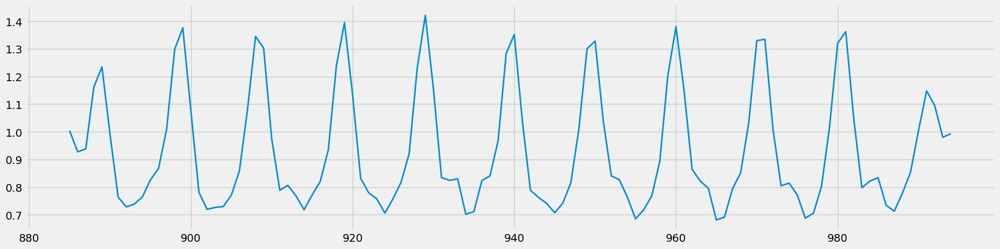

In [26]:
subset["acc_y"].plot()

<AxesSubplot: >

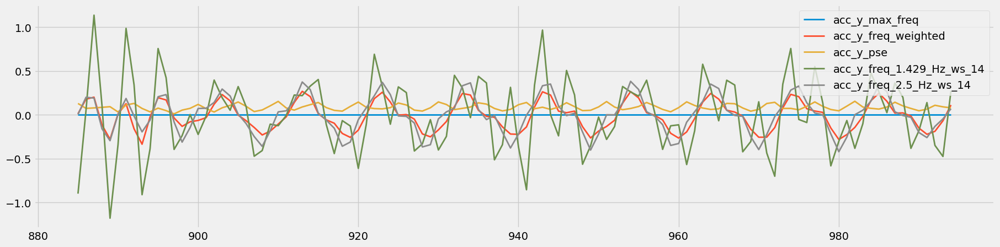

In [27]:
subset[
    [
        "acc_y_max_freq",
        "acc_y_freq_weighted",
        "acc_y_pse","acc_y_freq_1.429_Hz_ws_14",
        "acc_y_freq_2.5_Hz_ws_14",
    ]
].plot()

In [31]:
subset["acc_y_max_freq"]

885    0.0
886    0.0
887    0.0
888    0.0
889    0.0
      ... 
990    0.0
991    0.0
992    0.0
993    0.0
994    0.0
Name: acc_y_max_freq, Length: 110, dtype: float64

<AxesSubplot: >

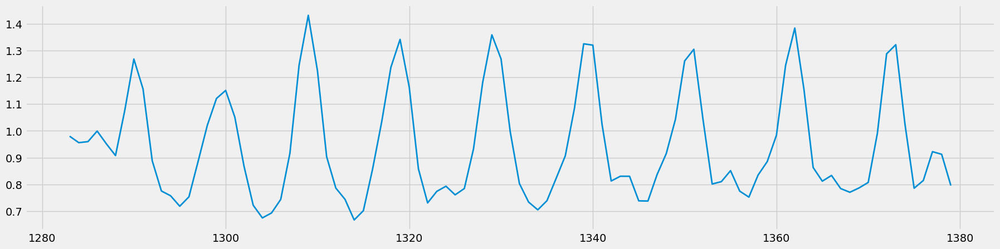

In [32]:
subset = df_freq[df_freq["set"]==17]
subset["acc_y"].plot()

<AxesSubplot: >

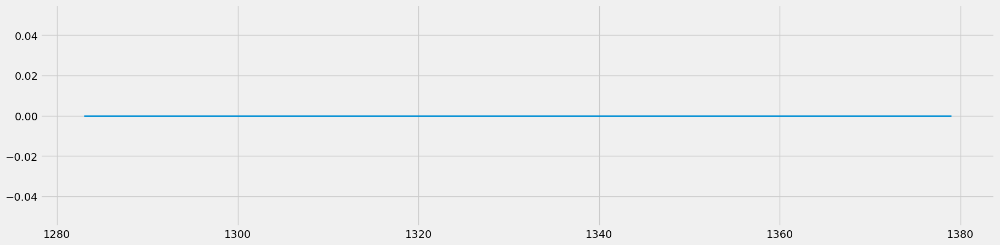

In [33]:
subset["acc_y_max_freq"].plot()

In [54]:
df_freq = df_temporal.copy().reset_index()

import importlib

import FrequencyAbstraction
importlib.reload(FrequencyAbstraction)

from FrequencyAbstraction import FourierTransformation

In [55]:
print("Data length:", len(df_freq))
print("NaNs in acc_y:", df_freq["acc_y"].isna().sum())

FreqAbs = FourierTransformation()

fs = int(1000/200)  # 5 Hz sampling rate
ws = int(2800/200)  # safer window size for FFT

try:
    df_freq = FreqAbs.abstract_frequency(df_freq, ["acc_y"], ws, fs)
except Exception as e:
    print("Error during frequency abstraction:", e)

print("Computed columns:", df_freq.columns)

Data length: 9009
NaNs in acc_y: 0
Window index: 14
Signal window: [ 0.00816415 -0.00117147 -0.00382278  0.00494482 -0.01118535 -0.05329126
 -0.08850474 -0.13241121 -0.1030253   0.10991628  0.26859285  0.11617016
 -0.0692527  -0.0273559  -0.01776753]
Real part of FFT: [ 9.99200722e-16  4.44723289e-02 -3.68030140e-01  5.24394277e-01
 -1.65833554e-01 -5.20982962e-02  3.42700614e-02  4.40564143e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 15
Signal window: [ 0.00927242  0.00662111  0.01538871 -0.00074146 -0.04284737 -0.07806085
 -0.12196732 -0.09258141  0.12036017  0.27903674  0.12661405 -0.05880881
 -0.01691201 -0.00732364 -0.13805032]
Real part of FFT: [-5.55111512e-16 -2.78746970e-01  8.38404731e-02  1.96190939e-02
 -2.15961884e-01  2.23032543e-01  1.24944961e-01  1.12814938e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax i

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 115
Signal window: [-0.11459512 -0.11415298  0.08542197  0.29518978  0.21706955 -0.01942194
 -0.05724383  0.03500491 -0.01252954 -0.10104072 -0.04706661  0.02703758
  0.00139171 -0.06362505 -0.1314397 ]
Real part of FFT: [-1.11022302e-16 -1.18922699e-01 -7.55055424e-01 -5.06211851e-01
  3.80745503e-01  3.55527151e-02  5.35026708e-02  5.09256803e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 116
Signal window: [-0.11452535  0.0850496   0.2948174   0.21669718 -0.01979432 -0.05761621
  0.03463254 -0.01290191 -0.10141309 -0.04743898  0.0266652   0.00101934
 -0.06399742 -0.13181207 -0.1093819 ]
Real part of FFT: [-3.33066907e-16  1.59120253e-01 -3.45931389e-01 -3.25682643e-01
 -2.92045720e-01  3.80519372e-02 -3.80082465e-02 -5.44443343e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (

In [56]:
subset = df_freq[df_freq["set"]==15]

<AxesSubplot: >

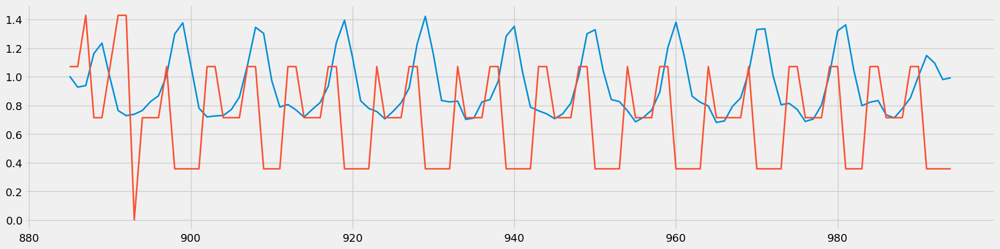

In [57]:
subset["acc_y"].plot()
subset["acc_y_max_freq"].plot()

<AxesSubplot: >

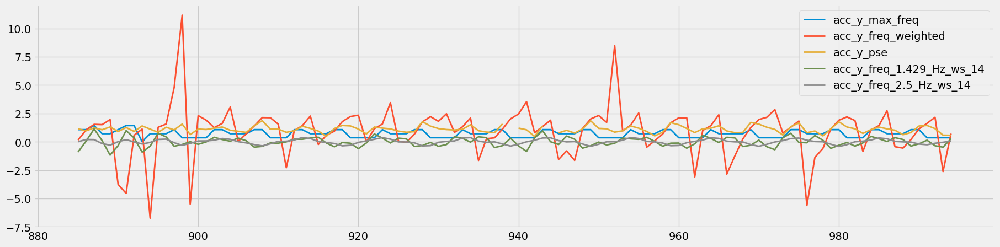

In [58]:
subset[
    [
        "acc_y_max_freq",
        "acc_y_freq_weighted",
        "acc_y_pse","acc_y_freq_1.429_Hz_ws_14",
        "acc_y_freq_2.5_Hz_ws_14",
    ]
].plot()

<AxesSubplot: >

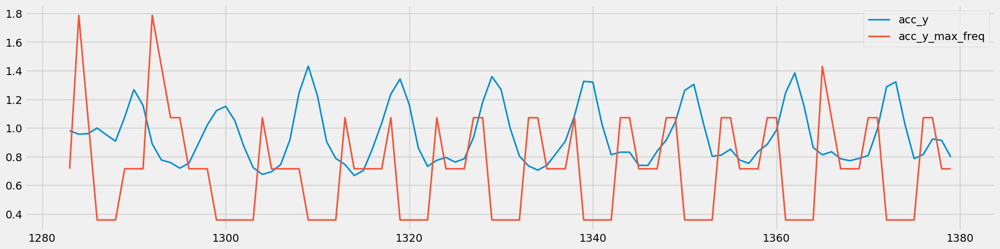

In [59]:
subset = df_freq[df_freq["set"] == 17]
subset[["acc_y", "acc_y_max_freq"]].plot()

In [60]:
df_freq_list = []
for s in  df_freq["set"].unique():
    print(f"Applying fourier transform to set {s}")
    subset = df_freq[df_freq["set"] == s].reset_index(drop=True).copy()
    subset = FreqAbs.abstract_frequency(subset, predictors_column, ws, fs)
    df_freq_list.append(subset)

Applying fourier transform to set 30
Window index: 14
Signal window: [ 0.12693804  0.11955015  0.10780196  0.08990597  0.08708556  0.09303074
  0.05050188 -0.04372176 -0.10930822 -0.10473668 -0.07268702 -0.06583684
 -0.0959194  -0.11761526 -0.0649891 ]
Real part of FFT: [-9.71445147e-17  3.49527224e-01 -1.81783241e-02  2.90556741e-01
  7.96951050e-02  1.00034698e-01  7.76476467e-02  7.27521743e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 14
Signal window: [ 0.00816415 -0.00117147 -0.00382278  0.00494482 -0.01118535 -0.05329126
 -0.08850474 -0.13241121 -0.1030253   0.10991628  0.26859285  0.11617016
 -0.0692527  -0.0273559  -0.01776753]
Real part of FFT: [ 9.99200722e-16  4.44723289e-02 -3.68030140e-01  5.24394277e-01
 -1.65833554e-01 -5.20982962e-02  3.42700614e-02  4.40564143e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 24
Signal window: [ 0.01149303 -0.02059059 -0.10416886 -0.13165823 -0.06693291  0.00975847
  0.03713822  0.04798187  0.06890596  0.07396915  0.0584747   0.05115037
  0.04559788 -0.00052175 -0.0805973 ]
Real part of FFT: [ 2.08166817e-16 -4.14280678e-01  1.46790026e-01  1.37670939e-01
  3.76696298e-02  5.48100732e-02  6.16445508e-02  6.18931550e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 24
Signal window: [ -5.34439306  22.13537812  15.29202617 -14.46637957 -31.85703062
 -21.77783331  -3.70787164  -1.1475724   -5.33009379   0.18620206
   2.83602348  -5.30654134   0.80532503  24.31211157  23.37064927]
Real part of FFT: [ 3.55271368e-15  8.10470344e+01  7.08338137e+01 -3.85443513e+01
 -7.90262801e+01 -3.37906758e+01 -2.21711559e+01 -1.84313329e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 15
Signal window: [-6.52362681e-01  8.20045547e-03 -1.88791623e+00 -8.53877187e+00
 -1.38232126e+01 -7.02415132e+00  8.08030649e+00  1.35531147e+01
  5.71062492e+00  6.11809824e-01  4.57808705e+00  5.74558254e+00
 -8.74594905e-01 -4.77198422e+00 -7.14732157e-01]
Real part of FFT: [ 3.55271368e-15 -3.24705211e+01  3.65950583e+01 -5.70801693e+00
  2.72860318e+00 -2.06041972e+00 -2.03805045e+00 -1.93937329e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 15
Signal window: [ -3.09245219 -10.39832387 -14.18318024  -2.27913667  11.39385994
   4.78888561 -11.24272687 -12.28557068   0.67868712  14.7688165
  22.44283676  16.81908639   2.67096171  -7.05069962 -13.03104389]
Real part of FFT: [-4.88498131e-15 -4.66477412e+01 -6.75932886e+01  5.29588415e+01
  2.17862932e+01  1.23819372e+00  7.38933399e+00  7.67497608e+00]
Freqs: [0.    0.357 0.714

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 30
Signal window: [ -7.99156027  -3.04983584   5.95599505   4.50130352  -0.16285025
  -2.39077607  -6.62266014  -7.1882993    4.37223424  14.46015768
   4.97124205 -10.71237837  -7.91684329   5.2364728    6.53779821]
Real part of FFT: [ 5.77315973e-15 -2.11098860e+00  5.13230264e+00 -9.28538766e+00
 -3.98097298e+01 -5.35440377e+00 -4.24234808e+00 -4.26614684e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 30
Signal window: [  7.33692681   9.34871524  -7.87594261 -10.89388375   5.29697606
  20.60287641  27.40837565  22.68106551  -3.95180075 -34.36167548
 -27.07876791   6.10815871  10.26579684 -11.46020723 -13.42661351]
Real part of FFT: [-1.59872116e-14 -2.01697810e+01  1.41809787e+01  1.97570143e+00
  5.82974191e+01 -3.66689881e-01  1.76886844e-01  9.32435766e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 21
Signal window: [ 0.01741907 -0.01642826 -0.03387387 -0.01094911  0.02340944  0.04341178
  0.04493143  0.02201363 -0.01862349 -0.04467574 -0.03658752 -0.00671107
  0.02037863  0.0173475  -0.02106241]
Real part of FFT: [-2.35922393e-16 -3.36552841e-02 -3.01377808e-02  2.08959572e-02
  5.43212084e-02  4.06564151e-02  3.97123517e-02  3.88501369e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 21
Signal window: [  0.88774964   6.9826416   -3.80715254 -20.05850164 -14.33371651
   3.84793911   6.03507111   3.00042961  12.95700204  14.96335064
  -3.22007796 -13.970073    -3.78886813   6.68798887   3.81621715]
Real part of FFT: [ 4.88498131e-15 -2.46407712e+01  7.55434562e+01  6.64760735e+00
 -4.29093672e+01 -2.94179755e+00 -2.85858036e+00 -2.18242483e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 27
Signal window: [ 21.68770796  -0.60701829 -28.42229322 -45.12055436 -30.20665074
   8.88056729  37.8347576   30.15454919  -6.19434652 -33.50987386
 -22.39716282  13.97060834  34.46807968  20.59107635  -1.12944659]
Real part of FFT: [ 0.         -6.91062712 75.82714485 -0.47682576 30.69704375 23.04017552
 20.90460681 19.57629165]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 27
Signal window: [ 0.11610701  0.04320069  0.15305975  0.19134171  0.02476053 -0.1131195
 -0.12852368 -0.1463125  -0.19355845 -0.17255407 -0.10977642 -0.05418136
  0.06129421  0.20129139  0.12697071]
Real part of FFT: [-2.22044605e-16  1.27728656e+00 -2.74752467e-01 -3.72434214e-01
 -6.94900073e-02  1.01497767e-01  1.05461920e-01  1.03233017e-01]
Freqs: [0.    0.357 0.714 1.071 1.42

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 14
Signal window: [-14.52755349  -7.24657413  24.07291683  22.99584705   6.25287752
 -13.43745695  10.04822225  37.56468122  15.68369738  -9.58176184
  -7.59281333 -14.96187427 -20.83498346 -11.44787382 -16.98735094]
Real part of FFT: [-7.28306304e-14 -6.85874744e+01  3.40117118e+01 -1.00634495e+02
  1.41359857e+01 -1.78503442e+01  1.17399358e+01  1.82280294e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 15
Signal window: [ 0.03123554 -0.04756298 -0.09259437 -0.10651339 -0.15070472 -0.17456867
 -0.08085876  0.04802426  0.08667445  0.08091176  0.09531329  0.09022007
  0.06002137  0.06195523  0.09844691]
Real part of FFT: [-1.38777878e-16 -4.29961163e-02  3.27959399e-01 -9.75433740e-02
  1.15979876e-01 -2.28052178e-02 -2.25062116e-02 -2.38217682e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 20
Signal window: [-11.49567596   8.82655261 -15.88603698   9.854223    16.50775507
   0.84168317 -24.75773254   1.46561689  16.2311613   -8.6899855
  -6.42835505   6.93187073  -0.26591964  -4.52901912  11.39386201]
Real part of FFT: [ 7.10542736e-14  6.37214085e+00 -1.78919033e+01 -1.94845340e+01
  7.24303298e+01 -5.30326360e+01 -2.32213356e+01 -5.13896315e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 21
Signal window: [ 0.04495236 -0.03671769 -0.09659514 -0.07182308  0.04040543  0.13916541
  0.10995041 -0.01055457 -0.09603822 -0.10232553 -0.05025514  0.03368157
  0.08551451  0.04968802 -0.03904834]
Real part of FFT: [ 6.80011603e-16 -5.52397024e-03 -2.23862768e-01  2.48807451e-01
  4.87185813e-02  9.94030053e-02  8.58491517e-02  8.37512795e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 28
Signal window: [-13.90802515 -21.17407374 -11.97004254  -3.85325537  -2.75735323
   8.4089741   21.2559152    6.28148002 -23.887618   -30.06801462
 -11.14812971  11.42795012  28.96951025  30.35766427  12.0650184 ]
Real part of FFT: [ 5.32907052e-15  2.26493022e+01 -6.81633213e+01 -4.04574710e+01
 -1.85414335e+01  3.59419546e+00 -1.16048088e+00 -2.23097963e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 28
Signal window: [-0.10733442 -0.17095346 -0.11079484  0.00438672  0.05690004  0.0454535
  0.06868362  0.20282481  0.26298683  0.11292795 -0.05921221 -0.08102801
 -0.04189764 -0.08507541 -0.09786747]
Real part of FFT: [ 1.99840144e-15 -1.08872683e+00  2.75751498e-01 -3.43538455e-01
  2.50362862e-01  5.51493390e-02  4.080

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 27
Signal window: [-14.58379339   5.87604622   9.58378995 -11.11246849  -1.72881424
  27.76840515   6.57890558 -11.41397089  13.6135023    3.55972479
 -12.87158955   2.43454409  -3.27658061 -22.07155909   7.6438582 ]
Real part of FFT: [ 6.03961325e-14 -3.29111226e+01  4.41276628e+00  2.78063385e+01
 -2.17628295e+01 -2.82513182e+01 -2.70237829e+01 -3.16485019e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 28
Signal window: [-0.05920071  0.01208392  0.11443018  0.13656782  0.03526966 -0.09642877
 -0.14860932 -0.09864942  0.00015323  0.06871739  0.06956503  0.0336111
 -0.00597188 -0.03892679 -0.02261144]
Real part of FFT: [ 7.35522754e-16  1.89269519e-01 -3.48403991e-01 -1.79773050e-01
 -1.65126917e-02 -1.27450419e-02 -3.53880837e-02 -4.04520179e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 22
Signal window: [-0.06126878 -0.04829263 -0.10415464 -0.0623337   0.03185574  0.03527103
  0.02644807  0.1606957   0.33994332  0.29797105  0.08845078 -0.08533692
 -0.17843428 -0.23161594 -0.20919879]
Real part of FFT: [ 3.33066907e-16 -1.40400470e+00  5.44377911e-01  1.28012253e-01
  1.81492101e-01  3.35735327e-02  2.81203105e-02  2.89127257e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 22
Signal window: [-21.51927558  -7.66840139   2.70645442   0.48006646 -10.73910046
 -26.13484218   1.63295232   1.59901896  -7.71977473  36.84574016
 -10.72630973  24.74628145  31.51140479 -30.22455167  15.2103372 ]
Real part of FFT: [-7.10542736e-15 -3.13331539e+01 -2.84494882e+01 -3.84980544e+01
  1.04963179e+01  7.34263322e+01 -1.07453014e+02 -3.95835061e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 30
Signal window: [-0.01386224  0.04606594 -0.02459419 -0.02961152  0.08079733  0.04138606
 -0.13842098 -0.1392097   0.04741138  0.10288065 -0.03581598 -0.09842403
  0.02550144  0.11808142  0.01781443]
Real part of FFT: [-1.11022302e-16  2.23382959e-01 -5.79529147e-02 -3.02276721e-03
 -1.64814106e-01 -8.02689822e-02 -1.77076142e-02 -3.58334052e-03]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 30
Signal window: [-26.49209372  20.97600324  15.08364651 -48.79523083 -28.48745142
  61.1119582   45.76030765 -58.65331748 -60.48273749  41.39425269
  58.03185075 -34.94543896 -65.41831207  16.33755336  64.57900958]
Real part of FFT: [   0.           30.47902435   40.44253483  289.78357293 -369.21135922
  -80.32661443  -58.15428486  -51.70357647]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (exc

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 31
Signal window: [-0.15660984 -0.17506321 -0.1648609  -0.10137445 -0.00918821  0.18826719
  0.43791306  0.40099668  0.10445956 -0.05041007 -0.05726109 -0.12474439
 -0.17619799 -0.0956807  -0.02024563]
Real part of FFT: [ 2.55351296e-15 -1.45455490e+00  6.11502939e-01  1.88207827e-02
 -1.30257810e-01 -7.00189472e-02 -8.28301352e-02 -6.72357464e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 31
Signal window: [ 14.7676423  -10.67183595   6.58501509  -9.51684626  -3.27460726
  18.226719   -23.27778255  19.48072326   9.46759178 -11.23881757
   8.67527803  -3.70997596  -0.47476979   6.91062083 -21.94895496]
Real part of FFT: [ 4.97379915e-14 -2.22022888e+01  8.77312228e+00 -7.48980083e+00
  2.93521273e+01 -4.46108608e+01  1.11663899e+02  3.52711189e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 27
Signal window: [-0.02901668 -0.04853157 -0.04060717  0.04627916  0.11873692  0.11808935
  0.09666392  0.09092715  0.05834472 -0.02766014 -0.10474158 -0.09950243
 -0.04793431 -0.04637853 -0.08466883]
Real part of FFT: [-4.44089210e-16 -4.19937163e-01  2.44883179e-02 -7.86145012e-02
  1.24434781e-01  5.74979297e-02  3.94422298e-02  3.50633163e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 27
Signal window: [ 0.36397354  0.23721917 -0.07349809 -0.31208172 -0.26228945 -0.05231852
  0.01183192 -0.12825613 -0.21139399 -0.12843657 -0.06820228 -0.03646126
  0.14755787  0.32672564  0.18562987]
Real part of FFT: [-1.44328993e-15  1.38691845e+00  7.59711932e-01  4.48788336e-01
 -3.24357914e-01  1.24267566e-01  1.59843528e-01  1.74629672e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (ex

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 33
Signal window: [-0.20719756 -0.19480516 -0.08686207  0.06713907  0.20516763  0.34921033
  0.39745231  0.19704026 -0.09097474 -0.23647476 -0.23680582 -0.20396549
 -0.11731538  0.01887183  0.13951953]
Real part of FFT: [ 2.55351296e-15 -6.09012399e-01 -1.07228120e-01 -5.19710263e-02
 -2.64785408e-01 -1.44594462e-01 -1.85011574e-01 -1.91378674e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 33
Signal window: [-11.1310885    1.21187088 -26.28758469  10.45562918   6.42707546
 -18.06927884  15.90015216  15.97470281  -6.33898006   7.2312391
 -12.78215518  11.18340015 -13.32224775  -3.00842137  22.55568664]
Real part of FFT: [-3.55271368e-14 -2.44609591e+01  2.43046576e+01 -3.82336763e+00
  3.34020648e+01  1.37005263e+01 -1.01132939e+02 -2.54731471e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 23
Signal window: [  5.70687862   7.10052754  -7.65359648   9.90463729 -21.0613381
   4.24576827 -16.38685074  11.23590984 -22.07598088  23.69817524
 -10.86570118  15.38372015   2.60113911  -1.11759968  -0.71568902]
Real part of FFT: [-2.13162821e-14  1.81267833e+01  1.99856420e+00  7.31327522e+00
  2.43829846e+00  3.82859693e+01 -9.59591093e+00 -1.57653899e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 5
Max freq (excluding DC): 1.786
--------------------------------------------------
Window index: 24
Signal window: [-0.04122754 -0.04957668 -0.07284798  0.0072446   0.13672652  0.14044846
  0.00971695 -0.08874981 -0.08340143 -0.07118178 -0.10885489 -0.10149185
  0.03079504  0.16810815  0.12429224]
Real part of FFT: [-5.55111512e-17  3.01160532e-01 -2.58488348e-01  3.67803006e-02
 -1.79534935e-01 -9.69790897e-02 -6.08652403e-02 -5.12797782e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 26
Signal window: [ -2.10445208  -1.01364106 -24.5837183   22.97163629  -0.78186374
   1.55371224  21.32876376 -14.70858907   2.85412813 -16.4189625
  10.71070452 -26.34160452  22.22522597  18.82935245 -14.52069206]
Real part of FFT: [ 7.10542736e-15 -1.85332937e+00 -3.73763143e+01 -2.38239984e+01
 -2.37004793e+01  7.20033172e+01  4.92239101e+01 -5.02564964e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 5
Max freq (excluding DC): 1.786
--------------------------------------------------
Window index: 27
Signal window: [-0.04387992 -0.11481938 -0.05958897  0.08002822  0.12300831  0.00960739
 -0.10030329 -0.07191785  0.01361914  0.00852462 -0.06368651 -0.04946836
  0.07331114  0.14053711  0.05502836]
Real part of FFT: [-5.55111512e-17  1.53675405e-01 -3.42916520e-01 -2.64449469e-01
  6.00378809e-02  2.65211486e-02  1.95518866e-02  1.84802850e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 24
Signal window: [ 0.04023175  0.10251831  0.15019195  0.18772866  0.20094292  0.11531537
 -0.10826403 -0.26567805 -0.22416663 -0.19872756 -0.25810999 -0.17318668
  0.06341343  0.19135475  0.1764358 ]
Real part of FFT: [ 9.99200722e-16  1.39721334e+00 -5.10104478e-01 -1.85852400e-01
 -2.28057578e-01 -2.34266154e-02 -7.05547579e-02 -7.74793763e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 24
Signal window: [ -1.92631747 -11.65838058 -11.39112468  -9.89009029  -9.6535635
   4.29623414  15.23661828  12.4294061   -0.4600324   -0.09087646
   8.04977092  13.82673809   6.51373018  -9.53761716  -5.74449517]
Real part of FFT: [ 1.06581410e-14 -6.34422447e+01 -3.29205699e+00  2.09915905e+01
  1.27161183e+01  1.47645964e+01  5.05762847e+00 -1.24301295e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 24
Signal window: [-1.94521099 -4.04740222  5.13320581  7.64919499  7.09036724  9.77332003
  2.25073187 -7.29361496 -9.13830278 -2.44927948 -0.02313525  5.44223644
 -0.46177512 -5.88710546 -6.09323012]
Real part of FFT: [ 1.42108547e-14  5.55801069e-01 -4.66730463e+01  1.65716525e+01
 -2.18722618e+00  7.56549191e+00  2.94078197e+00  6.63746263e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 25
Signal window: [-0.10806554 -0.11689702 -0.05057151  0.03831685  0.05240418  0.00506331
 -0.01002025  0.0327052   0.07764267  0.07181402  0.02674136  0.00413457
  0.01367282 -0.00030257 -0.03663808]
Real part of FFT: [-6.10622664e-16 -4.46043503e-01 -1.98845777e-01 -1.77314907e-01
  3.34046047e-02  8.57684775e-03 -1.33372832e-02 -1.69315614e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (ex

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 24
Signal window: [ 0.08401375  0.14584115  0.17672723  0.2100502   0.17617704 -0.01466738
 -0.25697219 -0.33878561 -0.29324153 -0.28759023 -0.24835502 -0.04204307
  0.18819751  0.25875879  0.24188937]
Real part of FFT: [-1.05471187e-15  2.02895202e+00 -7.69609929e-01 -3.49206758e-01
  1.22807995e-02 -9.34514456e-02 -9.83148672e-02 -1.00546698e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 24
Signal window: [ -5.64034346   1.68177925  -0.38188358   3.4611067   18.71603266
  33.49348663  31.2317002    9.92701173 -13.36159708 -24.52311518
 -26.25621444 -21.8842372  -10.35075096  -0.21892011   4.10594483]
Real part of FFT: [-1.77635684e-15 -8.23932413e+00  2.28479275e+00  1.33180092e+01
 -2.20251483e+01 -8.73210405e+00 -9.32568734e+00 -9.58311408e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 17
Signal window: [ 2.10795255  1.44538657  0.5217527  -1.07076659 -1.41897958  0.8419274
  1.39883083 -2.44068699 -5.39683712 -3.45951151 -0.2705047   1.35741321
  2.90155631  3.2414601   0.24100682]
Real part of FFT: [-8.88178420e-16  1.57864808e+01 -6.66034311e+00  4.35973616e+00
 -5.10271259e+00  2.81709238e+00  2.33870198e+00  2.27068858e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 17
Signal window: [-0.015994   -0.02724575 -0.0483314  -0.02546085 -0.01329558 -0.10927885
 -0.23484228 -0.20501531 -0.02844788  0.11279548  0.15831743  0.19281497
  0.22055703  0.1227889  -0.0993619 ]
Real part of FFT: [-1.99840144e-15  2.62269198e-01 -7.17439638e-01 -1.75171346e-02
  6.66981159e-02  8.55830542e-02  1.00128575e-01  1.00322801e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (exc

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 25
Signal window: [  2.17728025   3.40433814   8.01903186  25.10078785  42.3359799
  26.67176424 -17.26164696 -43.17755639 -31.77943227 -10.41951495
  -4.17615686  -7.99040505  -4.56917571   5.93204374   5.73266222]
Real part of FFT: [-3.55271368e-15  1.07079689e+02 -1.31650992e+02  6.23001902e+01
 -1.37124351e+01 -7.45840428e+00 -6.17971093e-01  3.89524890e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 25
Signal window: [-0.77985581 -1.68991953 -2.46162349  0.56326002  2.87387951  5.37793981
  4.69113481 -1.96310016 -5.95862382 -1.6969179   4.08118852  4.85318947
  1.2025363  -3.43149237 -5.66159536]
Real part of FFT: [ 1.77635684e-15 -1.11044218e+01 -2.51109095e+01  1.94684700e+01
  9.05009226e-01  5.97023614e+00  2.22971128e+00  1.79298611e+00]
Freq

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 23
Signal window: [-0.05651261 -0.03745409  0.00588232  0.06813497  0.11107847  0.1152277
  0.08673144  0.03458045 -0.00837677 -0.01326008 -0.01214814 -0.04218993
 -0.08111321 -0.09637149 -0.07420903]
Real part of FFT: [-2.77555756e-17 -3.66892759e-01 -1.83552289e-01  1.18560457e-01
  9.14777169e-03  5.97076129e-03 -2.14306985e-03 -4.93541221e-03]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 23
Signal window: [-0.05478552 -0.01266563 -0.00242747 -0.07279714 -0.06166276 -0.00446626
 -0.03402304 -0.12656361 -0.12447454  0.07582846  0.28434973  0.20642761
 -0.02947825 -0.06768798  0.02442642]
Real part of FFT: [ 1.99840144e-15 -6.59054502e-02 -4.54803725e-01  6.28946874e-01
 -2.28527505e-01 -1.72883259e-01 -6.62019830e-02 -5.15163748e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (exc

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 29
Signal window: [-0.06371212 -0.09640748  0.01558451  0.11211581  0.09334347  0.020421
  0.01287832  0.07558461  0.06733212 -0.03635945 -0.07175076 -0.0248281
 -0.04322835 -0.07460637  0.0136328 ]
Real part of FFT: [-9.99200722e-16 -2.59830440e-01 -8.67092536e-02 -2.50307806e-01
  2.26843048e-01 -2.74586759e-02 -3.72968770e-02 -4.30808599e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 29
Signal window: [  4.89308237   4.45000639  -2.32529915  -1.56493453  -4.74697486
   3.0602333  -12.44167102  -0.93398056   7.17422049   4.61754853
  -9.29733339  -4.28767059   8.56507347   1.70673465   1.13096488]
Real part of FFT: [ 1.06581410e-14  1.60297148e+01  1.82676301e+01 -1.50403109e+01
  1.24482956e+01  6.10364824e+00  1.16802

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 16
Signal window: [-0.06738443 -0.05782674 -0.06995963 -0.07494453 -0.07309123 -0.06881844
 -0.05275959 -0.04159468 -0.04200224 -0.01611026  0.02125049  0.009559
  0.01654279  0.16420279  0.35293673]
Real part of FFT: [-2.77555756e-16  4.15137716e-01  1.55755935e-01 -2.60378542e-02
 -2.42938654e-01 -2.91984047e-01 -2.61343103e-01 -2.53973224e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 16
Signal window: [ -4.24631746 -12.22246537 -11.33506057  -8.229977   -10.4287595
  -8.90794887  -0.68430851   1.70823691  -3.72826741  -6.11620649
  -4.82042943  -0.2706677   16.80460047  34.07832553  18.3992454 ]
Real part of FFT: [ 2.30926389e-14  3.47245749e+01  3.95536428e+00 -4.51762103e+01
 -2.32486885e+01 -3.70831349e+00  2.39470861e-01  1.36642117e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1


c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 16
Signal window: [ 18.8550618    5.16304078  -8.74190285 -13.15022487  -7.19835027
  -4.55418216  -8.94424816  -6.01092259   6.82027137  16.04016613
  15.83650352   7.69442957  -6.25794573 -12.88846656  -2.66322996]
Real part of FFT: [-7.10542736e-15 -1.15576400e+01  3.52960275e+01  6.58020227e+01
  2.33668719e+01  9.81421375e+00  9.54143515e+00  9.15003239e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 16
Signal window: [-9.63013526 -8.49452129  0.42052774  8.32940547  6.79128814  2.37951686
  1.99388765  1.24908885 -0.40638377  1.06866741 -0.50207617 -7.95951495
 -7.56723271  3.7787033   8.54877874]
Real part of FFT: [ 4.44089210e-15 -1.06537667e+01 -8.72917095e+00 -1.18461712e+01
 -1.74274781e+01 -8.70811116e+00 -7.53556524e+00 -7.32575109e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 25
Signal window: [ 0.20487029  0.2150634   0.00072093 -0.09760945 -0.05859942 -0.08947973
 -0.20835699 -0.27014747 -0.12359407  0.19640786  0.32446023  0.0717421
 -0.14545771 -0.055503    0.03548304]
Real part of FFT: [ 1.77635684e-15  5.97927967e-01  8.11513221e-02  1.07715141e+00
 -2.02127154e-01 -7.52189927e-02  2.24755532e-02  3.51670717e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 25
Signal window: [-1.14715957e+01 -4.27889351e-03 -2.07298257e+00 -7.77106328e+00
  8.43599824e+00 -1.73734006e+00  4.96622974e+00  1.36262213e+01
 -6.05656210e+00  5.11645509e+00  2.69594644e+00  2.07066062e+00
 -9.14467560e+00 -5.94168058e+00  7.28866738e+00]
Real part of FFT: [ 2.48689958e-14 -3.25459384e+01  7.20007461e+00  1.21456035e+01
 -3.59371436e+00 -2.74569747e+01 -3.84280770e+01 -3.35794180e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 15
Signal window: [ 0.0584797  -0.01106004 -0.05182795 -0.0315456  -0.01539006 -0.02215736
 -0.04718431 -0.06487777 -0.03828923  0.01594713  0.05842029  0.08086562
  0.07502244  0.03001858 -0.03642144]
Real part of FFT: [ 1.11022302e-16  1.15153415e-01 -1.92262201e-01  1.56584792e-01
  9.61333798e-02  1.06079032e-01  8.02717965e-02  7.66375446e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 15
Signal window: [ 11.78670882  11.94779906   5.81171303  -8.37068949 -14.10865138
   3.15602203  16.78926168  -4.02827439 -33.47868378 -28.78710247
  -3.22220463   5.41539557   3.04363116  13.19550908  20.84956571]
Real part of FFT: [ 5.32907052e-15  1.00156337e+02  6.61984505e+00  3.47378504e+01
 -3.51787592e+01 -8.30728542e+00 -5.43653486e+00 -4.19113694e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 36
Signal window: [  2.92713145   0.0548128    1.82326011   2.69531995   1.47694456
   0.31254723   1.83768718   3.55382245  -1.168479   -10.63179867
 -14.98227809 -10.09660853   0.42479541  10.20365862  11.56918453]
Real part of FFT: [  0.          35.57516283  22.15148098 -27.71573063  -0.91673765
  -4.12029701  -1.6407679   -1.37962477]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 36
Signal window: [ 41.61478988  36.40046291  -0.04616334 -12.54745681  -2.87616254
  -0.62390549  -9.92179228 -23.87352247 -30.31918992 -12.83093601
  11.50778843   4.29370836 -20.49721328 -10.100312    29.81990455]
Real part of FFT: [-1.77635684e-15  1.50935124e+02  5.03521632e+01  1.45154154e+02
  1.24046549e+01 -2.12739127e+01 -1.39074717e+01 -1.15537874e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max fr

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 23
Signal window: [  1.85498189  24.42127276  17.2807438  -10.48844562 -24.28623681
 -15.99322391  -5.63381048   3.91336638  21.20907605  29.54137418
  10.63570482 -14.36634931 -17.79913853 -10.93166317  -9.35765205]
Real part of FFT: [-5.32907052e-15 -2.60727230e+01  1.04981019e+02 -5.97994559e+00
 -4.98348426e+01 -3.78755785e+00 -2.77639739e+00 -2.61718816e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 23
Signal window: [ -2.28161132   3.05415125   5.56368359   0.17362337   1.57145719
  13.28472086  11.38312026  -5.72705405  -8.20716445   4.11452172
   2.04229198 -11.03908973 -10.35834815  -2.13937723  -1.43492529]
Real part of FFT: [ 7.10542736e-15 -7.24032231e+00  3.40268635e-01  3.21514582e+01
 -4.71218835e+01  4.54695882e+00  4.62045596e-01 -2.50610280e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 28
Signal window: [ 0.10331308  0.17961104  0.15429675 -0.01093368 -0.17640224 -0.1447525
  0.0325363   0.13699354  0.11792879  0.07705123  0.03573834 -0.04993171
 -0.15041102 -0.18441049 -0.12062743]
Real part of FFT: [-5.55111512e-17 -1.72655401e-01  8.19101814e-01 -7.48941268e-02
  6.40392979e-03  7.73338557e-02  6.06414443e-02  5.89166205e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 28
Signal window: [ 0.08275269  0.01578299  0.15052686  0.34589149  0.18311976 -0.20554788
 -0.3030738  -0.08226641  0.05582973 -0.02512003 -0.11878527 -0.09696497
 -0.04658024 -0.01913392  0.06356901]
Real part of FFT: [ 0.          0.78018995 -0.16770677 -0.61891279  0.52712641  0.08080516
  0.01496165  0.00418155]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 32
Signal window: [-15.73799864   6.46186597   3.3690902  -19.61397237   6.12760774
  17.8509866    3.10496517 -17.21700618  19.86355651  18.41515802
  -9.56805875   3.76268242   6.73542395  -3.13726237 -20.41703827]
Real part of FFT: [-5.32907052e-14 -5.74853931e+01 -1.94288993e+01  6.02920302e+00
 -2.92312299e+01 -1.06446358e+01 -2.46668800e+01  1.73928453e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 7
Max freq (excluding DC): 2.5
--------------------------------------------------
Window index: 33
Signal window: [ 0.03951924 -0.03555435 -0.09018418 -0.09605904 -0.02664196  0.09753352
  0.15443418  0.07662573 -0.04104307 -0.10029255 -0.1003063  -0.05006533
  0.03606073  0.08582409  0.05014929]
Real part of FFT: [ 2.49800181e-16 -3.78076972e-02  2.23935059e-01  5.75634416e-02
 -6.49633047e-02  5.04938337e-02  3.43027200e-02  3.28702180e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 27
Signal window: [ 0.09620579  0.09613275  0.04061328  0.12651751  0.28264804  0.20298884
 -0.11144768 -0.28809471 -0.1598441  -0.01414813 -0.03486953 -0.10500822
 -0.10757061 -0.05039217  0.02626894]
Real part of FFT: [-7.77156117e-16  6.44468211e-01 -5.42039012e-01  6.73204831e-01
 -2.10665761e-02 -1.56646736e-02 -1.23920734e-02 -4.96725520e-03]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 27
Signal window: [ -3.28591014   3.86399824  -4.4916597   -6.44175828  39.09117589
  18.07128619  20.89862755  28.57697116 -17.31731039 -22.61245389
 -13.51177015  -1.15262467   3.44647141 -20.71139407 -24.42364913]
Real part of FFT: [ 9.59232693e-14 -5.57303270e+01 -4.16179777e+01  1.98180599e+01
  6.38894020e+01 -1.19925350e+01 -1.66340451e+01  1.76230970e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 22
Signal window: [-0.09607256 -0.06887708  0.03570847  0.11673235  0.13595868  0.2095555
  0.24161623  0.08948651 -0.07992927 -0.0975061  -0.07012176 -0.1060563
 -0.12938793 -0.10103027 -0.08007647]
Real part of FFT: [ 8.88178420e-16 -4.78546461e-01 -2.24377732e-01  1.06457888e-01
 -1.73111285e-01  5.30729783e-02  1.94506754e-03 -5.98466907e-03]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 22
Signal window: [ -2.67421701 -11.24059724  -2.29926491  10.40058185   3.72030388
 -17.39231154  19.47663943  14.91798101 -23.98631895   6.50496368
   7.01463894  -9.12117858  -5.80203955   9.43499691   1.04582207]
Real part of FFT: [ 3.55271368e-15 -1.21878472e+01 -3.74593219e+00 -1.19992414e+01
 -3.39999134e+01  4.18588926e+01 -2.06304826e+01  2.06478966e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 5

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 29
Signal window: [ 0.12645906  0.23109419  0.19971618  0.036362   -0.10203147 -0.0740622
  0.03234941  0.06671724  0.04757743  0.04953496  0.04440982 -0.03024635
 -0.15983698 -0.25001932 -0.21802395]
Real part of FFT: [-6.93889390e-16 -8.28058385e-02  5.14286677e-01  1.33396285e-01
  4.03574807e-02  1.27302671e-01  1.08620398e-01  1.07285248e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 29
Signal window: [ 0.1008187   0.0584506   0.18547583  0.3011139   0.11973349 -0.17644177
 -0.24385191 -0.10461798  0.03011961  0.04230952 -0.05869725 -0.12666935
 -0.0801749  -0.03665263 -0.01091585]
Real part of FFT: [-6.66133815e-16  6.66316028e-01 -6.76578555e-02 -4.22928048e-01
  2.42988191e-01  1.80322964e-01  8.71272496e-02  6.99717491e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (exc

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 34
Signal window: [-22.21957778  -6.78852283  11.52492262  24.9767958   19.47645454
  -8.39973895 -23.724874    -7.40843401   7.98644755   8.6747796
  17.88173418  24.418014     0.97900424 -26.20545259 -21.17155239]
Real part of FFT: [ 5.32907052e-15 -4.72836055e+01 -1.12191630e+02 -2.20538270e+01
  5.10046978e+01 -1.69708082e+01 -9.79012933e+00 -9.36153116e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 34
Signal window: [ 0.21575366 -0.32010641 -0.48831646 -0.13425733  0.15393727  0.28611189
  0.35607295  0.01718291 -0.46040167 -0.38522253 -0.00694168  0.11392911
  0.24780072  0.38297812  0.02147945]
Real part of FFT: [ 1.88737914e-15  1.97077201e-01 -8.80420615e-01  8.28344094e-01
  2.17226231e-01  4.50221202e-01  4.08965585e-01  3.96738760e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 14
Signal window: [  0.63776254  12.48931563  21.35440548  23.2834857   11.68096026
 -10.73639265 -26.30463873 -23.00027044  -5.31212804  15.96215287
  26.83557968  15.64866641  -9.52760844 -26.78208697 -26.22920329]
Real part of FFT: [-1.59872116e-14  1.38593567e+01 -8.29600773e+01  3.39079656e+01
  1.79736626e+01  6.07673090e+00  7.93440833e+00  7.99117220e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 14
Signal window: [-0.15969287 -4.98646368 -3.67575514 -2.96682575 -2.67840983  0.98829288
  4.44097142  3.95566611  2.4952293   0.17797228 -5.04301684 -6.29861405
  1.20840708  7.55417766  4.98806144]
Real part of FFT: [ 1.33226763e-15 -5.18745860e+00  1.89872959e+01 -1.24946471e+01
 -1.00907806e+01  4.05124824e+00  1.95860500e+00  1.57804061e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 17
Signal window: [  6.80209176  -5.97507202 -29.26023201 -23.43853188   6.49513053
  19.16734989  13.29294895  11.58771931   2.75671948 -21.51294881
 -28.03157814  -1.47673365  22.26357025  19.28641296   8.04315338]
Real part of FFT: [-7.99360578e-15 -1.81880260e+00  2.02665787e+01 -4.99775566e+00
  4.12437729e+01 -3.88930460e+00 -1.57585565e-01  3.68785054e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 17
Signal window: [ 3.71737732e-04  2.12328050e-01  4.74563427e-01  1.39501416e-01
 -4.83350600e-01 -4.87097894e-01 -4.91095938e-02  1.27762053e-01
  2.32061368e-01  4.26568427e-01  1.12951306e-01 -4.95108376e-01
 -4.64577378e-01  5.06351001e-02  2.02500956e-01]
Real part of FFT: [-3.44169138e-15  2.62328386e-01  2.07554714e+00 -8.84310714e-01
 -1.42856058e+00  7.91319130e-02 -5.01264114e-02 -5.12217020e-02]
Freqs: [0.    0.357 0.71

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 24
Signal window: [-0.11611441  0.01656271  0.10716267  0.10626027  0.04244455 -0.05943794
 -0.13200426 -0.0881877   0.03391292  0.11325916  0.11929457  0.08203097
 -0.00664075 -0.10863233 -0.10991043]
Real part of FFT: [ 3.46944695e-16 -1.46276766e-01 -4.66075251e-01 -8.79270022e-02
 -1.15013261e-02 -5.28599898e-02 -5.27174515e-02 -5.35002747e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 24
Signal window: [ 26.20900118  28.49748656   5.25523431 -21.51794535 -28.17965977
 -17.42378411   1.22078616  22.72077611  30.30507108  10.29554715
 -19.27872698 -30.5375251  -21.29420162  -3.51071043  17.23865081]
Real part of FFT: [-8.88178420e-16  1.92335332e+01  2.19051446e+02 -2.06205380e+01
 -2.63306387e+00 -7.63021871e+00 -5.61323677e+00 -5.22041311e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 21
Signal window: [ 0.09208079 -0.49317566 -0.43951145  0.06759072  0.15887345 -0.00626925
  0.28114221  0.48155672 -0.12802428 -0.65252092 -0.34383717  0.20939024
  0.17794295  0.18138485  0.41337679]
Real part of FFT: [-3.77475828e-15  1.35385143e-02 -1.09931815e-01 -5.59473287e-01
  1.47727194e+00 -5.06463667e-02 -8.55907822e-02  5.43775890e-03]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 21
Signal window: [ 24.92633245  -9.23915647  -4.01776555  11.88996571  -8.27904331
 -26.96797417 -21.09797705  21.41507414  28.72358592 -24.69937631
  22.09835298  17.87034217 -17.97454409 -23.63599487   8.98817844]
Real part of FFT: [-7.81597009e-14 -6.24708901e+00  5.72764171e+01 -4.47726996e+00
  1.31918835e+02 -4.04333989e+01  5.46190481e+01 -5.70904925e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 32
Signal window: [-3.36117432e-02  5.11855842e-03  7.27647048e-02  6.71145859e-02
  2.63024274e-02 -2.38140329e-02 -1.13326757e-01 -1.52848436e-01
 -6.57986245e-02  1.72452382e-02  1.43951017e-04 -2.28056032e-03
  6.64411754e-02  9.14675591e-02  4.50819537e-02]
Real part of FFT: [ 3.88578059e-16  4.64337292e-01 -3.66333613e-01 -1.28063056e-01
 -1.93023270e-01  5.79374850e-03 -1.51415063e-02 -1.96576693e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 32
Signal window: [-10.11505609 -20.69578275  -2.30259251  19.73747831  22.51123837
  17.71013342   8.22909281 -10.79457916 -17.64787027  -2.71137459
   2.43973985 -12.56195057 -15.52832337   2.67860901  19.05123753]
Real part of FFT: [ 8.88178420e-15  2.17694712e+00 -5.87452644e+01  3.36071358e+01
 -3.34917047e+01 -5.82274402e-01 -8.52009286e+00 -1.03076673e+01]
Freqs: [0.    0.357 0.71

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 35
Signal window: [-0.07897768 -0.04547199 -0.03018768 -0.06676195 -0.06788963  0.01300064
  0.08893263  0.09039084  0.06856963  0.07266039  0.05992778  0.00191297
 -0.04302781 -0.03575321 -0.02732495]
Real part of FFT: [-3.05311332e-16 -5.39317040e-01  1.91249461e-01  1.45697012e-02
 -1.61898373e-01 -4.07616168e-02 -2.96928406e-02 -2.64818641e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 35
Signal window: [ 0.33014117  0.09290938 -0.13731566 -0.07026714  0.02971475 -0.03950659
 -0.10374935 -0.04137388  0.012387   -0.08452837 -0.22349376 -0.13821716
  0.13838532  0.22038106  0.01453324]
Real part of FFT: [-3.33066907e-16  8.28441249e-01  4.91212564e-01 -9.02268897e-02
  4.24011982e-01  3.14972435e-01  2.58078946e-01  2.49568511e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (ex

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 28
Signal window: [ 34.80457404  16.68668115  -7.65295248 -19.48674684 -17.12588816
  -4.82116516  14.11720897  30.55500141  26.43629628  -6.39561748
 -44.11627995 -50.36068633 -21.06285343  15.22845056  33.19397742]
Real part of FFT: [-1.06581410e-14  4.24414958e+01  2.45125508e+02 -3.66176146e+01
  4.35454639e+00  2.96484789e+00  1.28543695e+00  1.48008539e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 28
Signal window: [-0.12017256 -0.10972778 -0.07005501 -0.05316498 -0.14327917 -0.16201568
  0.01609209  0.17928308  0.15815689  0.14396849  0.20617026  0.14586908
 -0.01670203 -0.08621385 -0.08820882]
Real part of FFT: [-1.11022302e-15 -9.09056855e-01  1.53357724e-01 -1.76968902e-01
  1.08369765e-01 -4.49684828e-02 -1.30760607e-02 -1.89514120e-02]
Fre

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 23
Signal window: [ 0.10615101  0.16725124  0.22896395  0.10593324 -0.09823094 -0.14025953
 -0.03002091  0.02066852 -0.05991665 -0.13301561 -0.12704775 -0.10716103
 -0.0799721   0.01795319  0.12870335]
Real part of FFT: [ 8.88178420e-16  8.75173942e-01  5.05691716e-01 -3.72562685e-01
 -1.06627719e-01 -4.63865476e-02 -3.03279659e-02 -2.88281529e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 23
Signal window: [ 10.30310451  -9.29191938  14.82021975  20.20686636  -8.85064441
 -14.47035659 -15.02413809  -3.75964429  -0.8694542  -14.30919285
   7.8678433    4.77425788 -18.20409118   7.54223954  19.26490964]
Real part of FFT: [ 3.55271368e-15  6.69826419e+01  7.01371955e+00 -1.95086252e+01
  8.21673284e+00 -2.55411769e+01  2.87601033e+01  1.13498884e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 27
Signal window: [  4.48626989  12.85298848  14.86074804   3.1082568   -4.33041578
   2.06628142   3.87145832  -3.40554131  -3.25252555   0.88458394
  -6.21574355 -14.96988118  -9.67311059  -0.24497184  -0.03839708]
Real part of FFT: [  0.          30.70120801  33.18474023  -1.3245314  -37.03806036
   4.01618754   2.16655079   1.94092934]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 27
Signal window: [-10.24587485 -43.20194205 -32.313923     1.38834347  22.79169508
  27.06416694  17.29063746  -5.98865288 -26.17834881 -23.16650409
  -0.84835221  20.43860308  29.4033475   23.81819057  -0.25138621]
Real part of FFT: [-2.13162821e-14 -2.75210168e+01 -1.49940063e+02  2.20711188e+01
  2.17361566e+01  2.20049242e+01  1.78537309e+01  1.69510878e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max fr

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 30
Signal window: [ 0.2906775  -0.1440416  -0.27530618 -0.4010481  -0.25433373  0.30699499
  0.49707714  0.10888987 -0.19479762 -0.3253339  -0.39563583 -0.04031374
  0.46714069  0.38083119 -0.02080066]
Real part of FFT: [ 5.55111512e-16  2.51327076e-01  4.22996195e-01  4.37773887e-02
 -1.96167234e-01  7.92769986e-01  4.61314254e-01  4.04063594e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 5
Max freq (excluding DC): 1.786
--------------------------------------------------
Window index: 30
Signal window: [ 0.08583327 -0.03225449 -0.1456414  -0.15551614 -0.04342225  0.08292225
  0.12180022  0.05521304 -0.07783421 -0.16027715 -0.08964128  0.05365972
  0.1271115   0.12136553  0.05668139]
Real part of FFT: [9.71445147e-17 1.38671831e-01 8.84856811e-02 1.38856434e-01
 1.26951708e-01 2.84275533e-02 5.89291701e-02 6.34271319e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 19
Signal window: [ 0.48954216  0.21201637 -0.16500616 -0.30511332 -0.33096717 -0.19666755
  0.1746307   0.38372813  0.1670492  -0.12137611 -0.23814541 -0.3212126
 -0.26737546  0.10040205  0.41849518]
Real part of FFT: [ 1.33226763e-15  5.49158206e-01  2.75629411e+00  1.34320674e-01
  2.56988065e-01 -4.45380476e-02  2.50232384e-03  1.68408547e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 19
Signal window: [ 0.12405896  0.05837282 -0.04662358 -0.15269129 -0.16493833 -0.03040123
  0.11438713  0.12760085  0.05713682 -0.02109783 -0.10869606 -0.14420531
 -0.05216763  0.08795907  0.15130559]
Real part of FFT: [-3.46944695e-17  1.25653294e-01  9.95305808e-01 -3.41094814e-02
 -1.66322619e-01  1.87340246e-02 -3.48632809e-03 -5.33246218e-03]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (exc

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 37
Signal window: [ 22.23333056  12.5823119  -22.28143332 -25.5466486    0.43351922
  19.13985461   2.89515196 -19.75612763  19.66254512  13.89365316
 -20.57288397 -27.14534357  -6.18818814  18.76821558  11.88204312]
Real part of FFT: [ 2.13162821e-14  2.24429951e+01  9.65915885e+01  5.38858060e+01
 -2.40250479e+01  1.09309484e+01 -1.88505301e+00  8.80874211e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 38
Signal window: [ 0.01764655 -0.07188788 -0.12967641 -0.0496661   0.08516727  0.11424476
  0.06594433  0.05060006  0.02359553 -0.07409605 -0.13870397 -0.08061396
  0.02242151  0.07489608  0.09012828]
Real part of FFT: [-6.24500451e-17 -6.49899554e-02  1.30657013e-01  4.04602731e-03
  1.33534803e-01 -2.66246420e-02 -2.10776736e-02 -2.31964522e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 19
Signal window: [  4.0826609  -19.47227844 -27.41410902 -15.86079673   5.42017475
  25.7951847   28.08367008   4.84141784 -21.93176183 -28.59347625
 -17.83760058   0.80696969  22.30695963  29.8912546    9.88173067]
Real part of FFT: [-3.55271368e-15  1.14703823e+01 -3.36488590e+01  1.74506280e+01
 -4.65913693e+00  1.50285264e+01  1.26499846e+01  1.23284314e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 19
Signal window: [ -0.43064815   7.24157791   8.6832293    4.3328223   -1.73718329
  -8.86260852 -11.25920122  -2.20297066   8.28732758   8.49355593
   5.16064004   2.64172363  -5.36945141 -11.28505586  -3.69375759]
Real part of FFT: [-8.88178420e-16 -1.20836185e+00  8.72383802e+00 -5.59016860e+00
  1.04091445e+01 -6.34938383e+00 -4.74137298e+00 -4.47355636e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 25
Signal window: [-10.69524701 -29.3842775  -23.51421177  18.99868984  26.30744617
 -27.11560296  19.68246103  15.45410349 -20.39137131 -26.05280241
   6.57125028  24.69703361 -13.22979306   9.82333795  28.84898366]
Real part of FFT: [ 8.52651283e-14 -3.63871026e+00 -6.03861735e+01 -7.20895966e+00
  6.32522136e+01 -1.69450374e+01 -7.08900396e+01  1.56023543e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 26
Signal window: [-0.09429688 -0.06946677  0.03360303  0.05590195  0.0062061   0.01470632
  0.03313285 -0.03845541 -0.08151597  0.00919203  0.08747958  0.04826936
  0.0082642   0.01618478 -0.02920517]
Real part of FFT: [ 1.11022302e-16 -1.04974227e-01 -4.18335239e-01  1.21788474e-02
 -2.28699457e-01  1.82912307e-02  7.54367515e-03  6.76853544e-03]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 30
Signal window: [-0.03215396  0.02470335 -0.01184584 -0.05152814  0.00451182  0.08361125
  0.09565281  0.06224865  0.01966152 -0.01801302 -0.0253227  -0.01799283
 -0.03782442 -0.05813158 -0.0375769 ]
Real part of FFT: [ 8.88178420e-16 -2.89017297e-01  1.21697150e-01  1.04616534e-01
 -3.94346065e-02 -6.58001033e-02 -3.92800623e-02 -3.39363147e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 30
Signal window: [ 0.11382303  0.13256527 -0.00072972 -0.15865323 -0.14388995 -0.03262679
 -0.00878635 -0.07003519 -0.11943856 -0.11226855 -0.03970002  0.05309799
  0.09580427  0.11413311  0.17670469]
Real part of FFT: [-7.77156117e-16  7.81737984e-01  2.74227447e-01  1.83989694e-01
 -1.24477527e-01 -1.05121247e-01 -8.02491524e-02 -7.64345102e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (ex

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 30
Signal window: [-4.65915801  3.61756524  0.68772113 -5.77410526 -0.14464116 -0.45469644
 -4.34124488 -4.83610502  0.14441023  2.52151534 -2.14968124  2.48727445
 12.07621832  7.1769076  -6.3519803 ]
Real part of FFT: [-4.79616347e-14  7.17143247e+00 -1.82470890e+01 -1.56124043e+01
 -8.34351510e+00 -2.65161737e-01 -2.54643490e+00  2.89948757e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 31
Signal window: [-0.04424085 -0.09842939 -0.08187602  0.00511247  0.04088547  0.04809493
  0.10132354  0.14132497  0.12795555  0.10987638  0.04523833 -0.09507941
 -0.16311437 -0.09667027 -0.04040133]
Real part of FFT: [ 1.11022302e-15 -8.14627324e-01  3.26960051e-01  1.09129562e-01
  9.23452396e-03  1.34357451e-02  1.36014623e-02  1.04595902e-02]
Freqs: [0.    0.35

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 26
Signal window: [ 16.31367457  16.03960269   8.5903068    8.97417383   7.07481727
  -1.62763092  -2.42148882   5.71113829   6.65516116  -4.87644908
 -16.5220322  -16.60507106 -11.18276493 -10.31351782  -5.80991979]
Real part of FFT: [-3.55271368e-15  2.77025135e+01  5.25643971e+01 -1.06986916e+01
  3.07947808e+01  1.02107183e+01  6.10872021e+00  5.67012087e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 26
Signal window: [ 3.57149653  2.11412401 -1.11502502 -2.66218297 -1.81253918 -1.29173914
 -1.73947693 -1.51477808 -0.07870197  1.72950892  2.08340277  0.35509764
 -0.53477826  0.6612985   0.23429316]
Real part of FFT: [ 3.10862447e-15  5.74860001e+00  7.34768202e+00  8.87802736e+00
 -3.53664803e-03  5.46850940e-01  2.02987304e+00  2.23872725e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 23
Signal window: [-0.66970469 -1.32901159 -2.52422159 -3.96580848 -4.82637523 -3.91319489
 -2.15215518 -0.89248965  1.96466094  7.90720777 11.70233086  8.14862677
  0.87291611 -4.23723867 -6.08554248]
Real part of FFT: [ 4.44089210e-16 -2.28698081e+01 -6.80837630e+00  1.47381833e+01
  9.65224159e-01  2.98868330e+00  3.06039493e+00  2.90291361e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 23
Signal window: [-1.19153019 -2.43500748 -2.34594384 -3.44768636 -3.81763615 -1.54767917
  1.06745563  2.63725288  4.30275764  6.53333504  7.90080105  5.38712018
 -1.31453989 -6.39738841 -5.33131093]
Real part of FFT: [ 3.55271368e-15 -3.18865953e+01  2.35547810e+00  1.09070779e+01
  3.45277046e+00  2.47055133e+00  1.99690128e+00  1.76733975e+00]
Freqs: [0.    0.35

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 19
Signal window: [-0.08917843 -0.01691807  0.02143996  0.02436242  0.04896342  0.10409428
  0.12994312  0.08118914 -0.00661309 -0.02071023  0.07022603  0.08288522
 -0.09378561 -0.21724955 -0.11864859]
Real part of FFT: [-8.88178420e-16 -6.27759606e-01 -2.17502162e-01  2.71992311e-01
  8.98893144e-02 -7.40531111e-02 -5.91376342e-02 -5.22673429e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 19
Signal window: [-0.80193964 -1.2142823   0.71284133  1.16300396 -3.89086329 -1.9423541
 -0.44706594 -7.02321692 -5.0310045  -3.44127459  5.50379243  6.80879129
  4.94193966  5.00299983 -0.34136722]
Real part of FFT: [ 9.76996262e-15  1.63388950e+01 -2.42278695e+01  2.16775680e+00
 -8.37890920e+00  2.12199518e+00  4.73098993e+00  1.23259449e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (exc

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 29
Signal window: [-7.67515308 -2.58939431  2.51526236  1.16940531 -0.032535    2.18239597
  3.57999095  3.9328654   5.07371251  4.15873288 -0.05964454 -3.05554234
 -2.89229124 -2.92859879 -3.37920607]
Real part of FFT: [-2.66453526e-15 -2.97458233e+01  2.34665839e+00 -1.15179062e+01
 -1.12960183e+01 -2.48897278e+00 -2.36309795e+00 -2.49848792e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 29
Signal window: [-0.09084831 -0.13802499 -0.10252578  0.01335261  0.05795581  0.0635443
  0.17191313  0.2157815   0.08669235  0.06766865  0.16070675 -0.01377468
 -0.30168381 -0.21977526  0.02901773]
Real part of FFT: [ 1.11022302e-16 -1.10162563e+00  2.98183336e-01  4.36710565e-01
  8.35095235e-02 -2.09396601e-01 -1.03203731e-01 -8.55398118e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (exc

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 23
Signal window: [-31.68723555 -25.84452951  -3.36412546   0.8242899   -2.44580133
   4.98123678   9.65379202   6.29980865  20.38281922  49.25186077
  46.93334549   4.1960749  -31.05805742 -31.30973791 -16.81374056]
Real part of FFT: [-3.55271368e-15 -2.03097063e+02 -1.72378280e+01  5.67136054e+01
 -5.68146717e+01 -4.52302541e+00 -6.14523862e+00 -6.55004552e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 23
Signal window: [  0.6301848   -8.84530445  -9.64094636   1.36640905   8.84546023
   1.58662882  -7.24014948  -3.65320124   3.26033032   4.60113165
   8.69726656  14.43039207   6.8734906   -8.94297594 -11.96871662]
Real part of FFT: [ 2.66453526e-15 -3.33288125e+01 -4.71043573e+01  1.95456559e+01
  4.15236603e+01  9.34659992e+00  7.73954458e+00  7.00409523e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 26
Signal window: [ 3.62476556  4.2447477   1.82210025 -2.80369667 -3.74282223  0.30390779
  1.73649981 -2.78928848 -6.74465799 -4.80415633  0.32101413  3.15744306
  2.50966468  1.42862251  1.73585619]
Real part of FFT: [-1.33226763e-15  2.27287372e+01 -1.87287074e+00  1.02900573e+01
 -5.01582588e+00  3.94615586e-01  3.34161475e-01  3.26866809e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 26
Signal window: [-0.04247275 -0.01239954  0.02178719  0.10224854  0.12454536  0.10494948
  0.17838097  0.24731751  0.08659616 -0.20140638 -0.26505878 -0.0870229
 -0.02154247 -0.11663421 -0.11928816]
Real part of FFT: [ 4.21884749e-15 -4.33157363e-01  1.55314817e-01 -4.97497510e-01
  4.45399219e-01  2.28118391e-02 -8.95761673e-03 -2.45903817e-03]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (exc

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 18
Signal window: [-0.05491225 -0.07571587 -0.10501835 -0.08947877 -0.06742389 -0.00386061
  0.14442695  0.25576217  0.21359256  0.08455842 -0.02462944 -0.08280479
 -0.08636278 -0.06014112 -0.04799225]
Real part of FFT: [-1.11022302e-16 -9.47179583e-01  6.82561641e-01 -2.01133383e-01
  7.10419233e-02 -2.65263873e-03 -7.37233953e-03 -7.10746757e-03]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 18
Signal window: [  0.10947369   1.96787976   2.57754991   1.22038808  14.29606339
  39.70130311  34.72353796  -9.15923368 -40.50373493 -32.34574042
 -10.79991601   0.44600069   0.8239933   -1.70916001  -1.34840484]
Real part of FFT: [-4.44089210e-15  3.25505831e+01 -7.47259351e+01  7.23143214e+01
 -3.63107828e+01  6.79747892e+00  2.12830582e-01 -1.74434832e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 20
Signal window: [ 0.17882838  0.10156526 -0.11807521 -0.25495787 -0.1335343  -0.00893944
 -0.05143467 -0.1017777  -0.05382027 -0.03719646 -0.0123806   0.1315804
  0.21510631  0.10707216  0.037964  ]
Real part of FFT: [-2.99760217e-15  5.21383536e-01  1.48619261e-01  3.39656588e-01
  1.39155173e-01  7.55185421e-02  5.41142636e-02  6.27654546e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 20
Signal window: [ -9.76199809   0.91979959  42.02106209  38.51613063 -15.44295421
  12.57774368  20.38561763  11.89451925  -2.88541108 -19.80124849
 -17.11328612 -19.63721327 -12.4014257  -19.84388408  -9.42745183]
Real part of FFT: [ 4.97379915e-14  2.02483617e+00  6.09204770e+00 -7.39438132e+01
 -4.67194231e+01  2.54056140e+01  3.81999618e+01 -2.42742091e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 16
Signal window: [-0.10916631 -0.16304307 -0.1188384   0.08577989  0.24201125  0.18397371
  0.09048484  0.11158048  0.10401177 -0.02206583 -0.12775243 -0.11682065
 -0.05724892 -0.03088882 -0.0720175 ]
Real part of FFT: [ 8.88178420e-16 -7.22705140e-01 -2.06353382e-01 -1.42122049e-01
  2.45839974e-01 -1.83245016e-02  9.75947396e-03  1.51582972e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 16
Signal window: [-0.08181288 -0.07685573 -0.07154291 -0.01661759  0.12061705  0.24510987
  0.21986547  0.08386971 -0.01725009 -0.06455862 -0.10071044 -0.08861635
 -0.03721263 -0.03675204 -0.07753282]
Real part of FFT: [-2.77555756e-17 -5.78306150e-01 -1.24898129e-01  1.50024692e-01
 -1.00415167e-01  2.94956284e-02  6.44169751e-03  4.06086100e-03]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (ex

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 29
Signal window: [-0.05317997 -0.07910385 -0.09490964 -0.09983022 -0.10465135 -0.05201946
  0.11025625  0.27702772  0.278355    0.12301615 -0.02069672 -0.06451483
 -0.06361973 -0.07361084 -0.08251849]
Real part of FFT: [ 5.55111512e-17 -1.04202717e+00  7.69802626e-01 -3.36774621e-01
  1.42762589e-01  2.49637161e-02  2.20342444e-02  2.03888499e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 29
Signal window: [ -8.88383612  -4.3966565    0.10715676  -6.68781869   6.96684378
  49.58988672  60.7327729    8.16243105 -47.40282699 -48.98597503
 -18.2214946    1.37837061   2.36532841   1.02292583   4.2528919 ]
Real part of FFT: [ 1.68753900e-14  2.72830982e+00 -6.16661639e+01  6.29777628e+01
 -5.51306916e+01 -2.18929282e+00 -6.76637280e+00 -6.58232245e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 21
Signal window: [-0.0409454  -0.14929992 -0.16105993 -0.02550665  0.11853114  0.13154739
  0.06158803 -0.01677824 -0.10459183 -0.13992696 -0.04784926  0.09215943
  0.1555335   0.1193825   0.00721618]
Real part of FFT: [-2.22044605e-16 -4.02293515e-02 -6.19876111e-01  6.64596020e-02
  1.87645020e-01  1.61137872e-02  4.04222238e-02  4.23743126e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 21
Signal window: [-19.87615674  -2.44680928  19.07729001  29.97292421  18.63880758
  -6.47896688 -23.68062751 -23.18599218  -8.35392943  15.28214438
  33.45780443  26.84606193  -2.02941897 -26.98138893 -30.24174262]
Real part of FFT: [-8.88178420e-15 -2.69911594e+01 -1.52918395e+02  1.77657987e+01
  1.36603866e+01 -4.96701939e-01 -9.09669287e-03 -8.20073693e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 23
Signal window: [  6.52686047  27.08565522  29.23920117   5.96159826 -20.72210963
 -27.40725202 -16.68710462   1.98561868  23.48964846  31.06152074
  11.05514696 -18.52227101 -29.7728572  -20.52369215  -2.76996334]
Real part of FFT: [-2.13162821e-14  2.94456949e+00  1.15427531e+02 -1.83937301e+01
 -3.41562985e+01 -4.36497352e+00 -6.16938138e+00 -6.33626374e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 23
Signal window: [ -1.7290889   -8.80855702 -11.27455319  -2.21031845   8.31406211
   8.49971931   5.15791124   2.65443302  -5.35901616 -11.28211084
  -3.68631429   6.32818282   6.50367322   4.02474269   2.86723446]
Real part of FFT: [ 5.32907052e-15 -7.01827845e+00 -2.95124157e+01  8.46044389e+00
  2.14245688e+01 -5.33990061e+00 -7.49653606e-01 -2.32931044e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 21
Signal window: [-2.5149589  -0.40559681 -1.10329964  0.61238786 -3.72432744  8.75715154
  8.09886965  1.01627888  1.86912862 -0.04728931 -3.66372374 -3.30721861
 -1.74259812 -1.31424874 -2.53055522]
Real part of FFT: [  0.         -18.31211399   6.14263591   2.52220928 -13.74608418
   6.60961676   3.92396294  -6.0024185 ]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 5
Max freq (excluding DC): 1.786
--------------------------------------------------
Window index: 22
Signal window: [-0.01864726 -0.00090351  0.00323203 -0.00973157 -0.01301659  0.00640277
  0.01268063 -0.01545342 -0.03119348  0.00093813  0.04080481  0.04290822
  0.014271   -0.01430443 -0.01798734]
Real part of FFT: [ 8.32667268e-17 -3.40296069e-02 -1.25050653e-01  7.91916041e-02
 -4.29665442e-02 -7.33601784e-04 -7.79078845e-03 -8.47487505e-03]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
-----

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 26
Signal window: [-7.79158582 -5.78597554 -4.20048108  4.7537094   6.06543772  4.18774057
  4.25138361 -1.08803579 -6.68400165  1.10887351  1.41085114  2.39110981
  2.83693497  1.2658619  -2.72182276]
Real part of FFT: [ 2.04281037e-14 -1.55994368e+01 -3.58333696e+01  1.96848594e+00
 -6.29705241e+00  7.73897351e+00 -7.45097120e+00 -2.96352304e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 5
Max freq (excluding DC): 1.786
--------------------------------------------------
Window index: 27
Signal window: [-0.04325213 -0.0557235  -0.04065151 -0.00903223  0.00790162  0.02737549
  0.06474162  0.08189863  0.05388742  0.01276452 -0.00621124 -0.00523793
 -0.00858658 -0.02987758 -0.0499966 ]
Real part of FFT: [ 0.         -0.39885306  0.04244335 -0.06852342  0.05134809  0.02495279
  0.01330371  0.01093755]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
-------------

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 16
Signal window: [ -3.78771117  -5.38354103 -12.07823893  -6.71097851  17.50359911
  22.53064141  -7.9765964   21.02095599  18.23191197  -0.81093584
 -10.35951398  -5.51048056 -13.69659996  -4.12798563  -8.84452648]
Real part of FFT: [-5.68434189e-14 -7.25610887e+01  2.02231215e+01  2.84223386e+00
  4.54905715e+01 -4.94742328e+01  1.81163068e+01  6.95525411e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 17
Signal window: [ 0.01176668  0.02049963  0.00642953 -0.0200991  -0.03639162 -0.03949398
 -0.03569761 -0.02774136 -0.01255981  0.01260802  0.03186834  0.02787121
  0.01775791  0.02192161  0.02126056]
Real part of FFT: [-2.01227923e-16  1.30967475e-01  6.83527552e-03  1.88394658e-02
 -3.33113558e-02 -2.04961504e-02 -8.48686350e-03 -6.09773593e-03]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 16
Signal window: [-0.06380751 -0.07693976 -0.05243652 -0.07662422 -0.10058785 -0.08574146
 -0.06624677 -0.00109155  0.14783312  0.25799634  0.21603843  0.08754277
 -0.02201777 -0.08030899 -0.08360826]
Real part of FFT: [-1.94289029e-16 -6.92230033e-01  6.33641278e-02  1.40580117e-01
 -8.16681732e-02  4.39501084e-02  2.56435480e-02  2.18039965e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 16
Signal window: [-12.74644537  -3.72381385   0.5155065    3.01743985   4.00993274
   2.12766441  15.24560631  40.91590774  35.78888323  -8.16721861
 -39.39530194 -31.25287839  -9.76314671   1.51805736   1.90980674]
Real part of FFT: [-1.59872116e-14 -7.44011028e+01  1.08826669e+02 -1.15049109e+02
  2.27146432e+01 -1.86206468e+01 -9.98609856e+00 -9.08269596e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 25
Signal window: [ 0.02687854  0.13495262  0.12290336  0.06055577  0.033039    0.07679408
  0.1791307   0.19897486 -0.00968974 -0.25532409 -0.19710713 -0.03065979
 -0.08157229 -0.18522107 -0.07365482]
Real part of FFT: [ 9.99200722e-16 -2.89154763e-02  2.98616286e-01 -1.83018356e-01
  3.25560885e-01 -1.05497042e-01 -5.05679218e-02 -5.45893006e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 25
Signal window: [-13.09465395 -12.61618433  -6.73405504 -13.75271368  -4.69997893
  -4.64100962 -13.21362169  -9.67798613  18.57580121  28.0762886
   0.62227243   3.87722154  17.26766981  11.32150183  -1.31055205]
Real part of FFT: [ 3.73034936e-14 -4.02937349e+01 -1.02011156e+01 -3.08318840e+01
 -1.98525399e+01  7.92445364e+00 -1.19515939e+01  6.99650992e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 28
Signal window: [-0.00148196  0.0007361   0.0059381  -0.00421465 -0.03471038 -0.05595793
 -0.05623823 -0.04817868 -0.03996167 -0.03550623 -0.01681321  0.03169821
  0.07207034  0.08694475  0.09567543]
Real part of FFT: [ 1.11022302e-15  3.66851200e-01 -7.11142750e-02 -1.32474881e-01
 -3.25650510e-02 -3.80560894e-02 -5.31578683e-02 -5.05977450e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 28
Signal window: [-0.04517075 -0.0540614  -0.06322788 -0.07590657 -0.09566447 -0.1092917
 -0.09119996 -0.04070923 -0.00055435  0.0084996   0.03861133  0.11587785
  0.16674996  0.14717799  0.09886957]
Real part of FFT: [-2.22044605e-16  2.20504471e-01 -1.45140718e-01 -2.29342153e-01
 -1.07966226e-02 -5.55415680e-02 -6.02856577e-02 -5.81783943e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (exc

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 20
Signal window: [-0.68974725 -0.70960965 -1.44025614 -1.84001536 -1.1574745  -0.43786325
 -0.89024112 -1.58584797 -0.46385073  2.11338273  3.43757942  2.57151009
  1.19310599  0.37227255 -0.4729448 ]
Real part of FFT: [-6.66133815e-16 -3.31689053e+00 -5.22355027e+00  5.80509070e+00
 -2.29052785e+00 -1.70272515e-01 -3.01684078e-02  5.32144662e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 20
Signal window: [ 0.68513219  0.33199872  0.6334346   1.45497399  2.24928436  2.12884504
  1.45848914  1.60204485  1.82509004  0.60507225 -1.17986233 -2.63306048
 -3.95134344 -3.70215688 -1.50794205]
Real part of FFT: [-1.11022302e-15 -8.67001791e+00  5.90806403e+00  3.51945404e+00
  2.83695083e+00  3.78486202e-01  5.65833215e-01  5.99721033e-01]
Freqs: [0.    0.35

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 19
Signal window: [ 3.8959888  -0.95301546 -1.86196243  1.65026876  1.84523929 -0.93793588
 -1.01218503  0.8656266   1.18927447  0.46070799  0.04312248 -1.18181546
 -3.4435821  -2.92312604  2.36339401]
Real part of FFT: [7.77156117e-15 2.42638031e-01 8.29602520e+00 7.13118878e+00
 1.07495486e+01 2.32679764e+00 3.71749727e-01 1.01968003e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 19
Signal window: [-1.76225493 -1.79803739 -0.81358959 -0.48505015 -0.42649512  0.8343114
  2.56141707  3.39383247  2.79533956  0.69724227 -1.23513495 -0.90923789
  0.25617557 -0.6230892  -2.48542913]
Real part of FFT: [-8.88178420e-16 -1.50576488e+01  3.87491070e+00 -6.55220989e+00
  5.05259626e-01  1.90129475e+00  1.14451369e+00  9.66968031e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding D

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 20
Signal window: [ 0.06957691  0.06164743  0.0589399   0.06554608  0.06273041  0.06368372
  0.06111736  0.02120033 -0.04450494 -0.09093471 -0.10010019 -0.07933169
 -0.0503186  -0.04383189 -0.05542012]
Real part of FFT: [3.46944695e-17 1.56942267e-01 6.37881388e-02 1.50525398e-02
 7.04247846e-02 8.24805618e-02 6.78485818e-02 6.52899826e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 20
Signal window: [ -2.41751288  -2.80014291  -3.63649571  -2.51645103  -2.28616736
  -4.43584801  -0.38175559  13.14200162  21.34901516  12.43593729
  -5.48913005 -16.39892519 -10.21540673   3.88725463  -0.23637323]
Real part of FFT: [  0.         -45.53180847  64.29806527 -33.13628785  -5.05998543
  -4.64278342   2.28006047   3.66139281]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.71

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 23
Signal window: [-11.37111261  -2.00576291   9.63369257  11.90090243  -1.60708537
 -16.15193312  -8.4565615   12.75209375  16.93089332   3.51523136
  -5.77878231  -8.77251867 -10.48020844  -2.1457904   12.0369419 ]
Real part of FFT: [-7.10542736e-15 -9.74417226e+00  4.01169373e+01 -6.61576990e+01
  6.03762150e+00 -2.23376231e+01 -1.70968711e+01 -1.61015379e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 23
Signal window: [-0.08661909 -0.04416302  0.04495224  0.10435352  0.13864773  0.22118732
  0.2040878  -0.0668502  -0.28082036 -0.13303532  0.03649251 -0.09659566
 -0.19515916 -0.00284288  0.15636459]
Real part of FFT: [-9.99200722e-16  1.65353229e-01 -4.08109398e-01  5.61351657e-01
 -5.48140104e-01 -1.59558380e-01 -1.33699824e-01 -1.26840353e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 27
Signal window: [ 0.13613717  0.08504564  0.15896755  0.25191735  0.17012379  0.00762395
 -0.03903899 -0.04118036 -0.10918986 -0.1401636  -0.08932316 -0.07537878
 -0.11341971 -0.11504183 -0.08707918]
Real part of FFT: [ 3.05311332e-16  5.29477871e-01 -2.26433654e-01  1.77919511e-03
  3.07946127e-01  1.43148341e-01  1.34315710e-01  1.30795172e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 27
Signal window: [-0.3293025  -0.27271508 -0.20541903 -0.15912614 -0.0566224   0.08140233
  0.12311874  0.09209496  0.09768302  0.10649332  0.08035267  0.08801081
  0.12772282  0.12632728  0.09997919]
Real part of FFT: [ 1.66533454e-16 -1.00528087e+00 -2.78467382e-01 -2.04413467e-01
 -3.54564004e-01 -1.96640639e-01 -2.14455278e-01 -2.15947123e-01]
Freqs: [0.    0.35

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 28
Signal window: [ 0.05893789  0.0139179  -0.02219619 -0.01705596 -0.0138461  -0.01015011
 -0.01952481 -0.06532196 -0.07084483  0.00505117  0.05529518  0.02799445
  0.00468591  0.01920009  0.03385735]
Real part of FFT: [-2.77555756e-16  2.17604619e-01 -6.40523220e-02  2.41338520e-01
 -3.59992330e-02  4.81413067e-02  1.88688888e-02  1.61324141e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 28
Signal window: [ 11.62287884  12.83525579  -8.06793817 -13.53679399  -4.53711906
   3.88270476  15.60789968  16.29801385  -4.28725285 -12.39239438
   2.04915608   1.13278927 -14.09206379  -9.76046282   3.24532677]
Real part of FFT: [  0.         -11.1138699   58.92870816  49.5243481   18.20245025
 -19.18571045  -5.63749887  -3.54683596]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding D

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 28
Signal window: [-0.04111708  0.0440286   0.10864483  0.05176051 -0.10042982 -0.17321605
 -0.03844286  0.1411133   0.1167573  -0.04194132 -0.09679133  0.00626768
  0.09516203  0.01808226 -0.08987807]
Real part of FFT: [ 7.77156117e-16  4.83885521e-03  2.33938829e-01 -8.09239404e-01
  1.71682827e-01  3.81319262e-02  3.14282777e-02  2.08406098e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 28
Signal window: [-14.96678226  25.55451869  29.06130019  28.2410579    3.41602938
 -27.67040966  -2.96130237 -47.41191575  -7.23855492 -20.64067901
 -31.86741023  20.07882986  23.69599131  28.79941203  -6.09008516]
Real part of FFT: [-1.42108547e-14  1.57444326e+02 -1.00440214e+02 -1.13137959e+02
 -2.37896222e+01  2.00524284e+01 -7.31235460e+01  2.07437199e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 18
Signal window: [ -1.98986174  -2.28227758  -1.73643863  -2.32094442   0.97548804
  11.60927328  21.4141752   18.30250658   0.8882773  -19.2600247
 -28.48285196 -22.94979679  -8.16586735   9.84385028  24.15449247]
Real part of FFT: [ 1.77635684e-15  1.03952815e+01  6.84102896e+01 -3.18300152e+01
 -1.59863232e+01 -1.54837845e+01 -1.53285858e+01 -1.51008255e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 18
Signal window: [  0.49325668   0.9235747   -0.25167132   0.54506368  -1.61389808
  -9.3089023  -10.69289356   0.04324623   9.49536605   8.99009648
   6.23534588   5.93805653   3.06450992  -4.2555972   -9.60555368]
Real part of FFT: [ 2.66453526e-15 -1.62064559e+01 -2.27031404e+00 -1.14437826e+01
  2.01722268e+01  3.60004979e+00  4.99303320e+00  4.854

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 26
Signal window: [-0.07340873 -0.08491043 -0.10581884 -0.06634939  0.09677958  0.2186314
  0.12270697 -0.06269996 -0.11446998 -0.07460735 -0.09244841 -0.10868314
  0.00364224  0.16263519  0.17900087]
Real part of FFT: [ 2.77555756e-17  1.03724852e-01 -1.64094961e-01  2.41134267e-01
 -3.89625377e-01 -1.32024399e-01 -1.09198615e-01 -1.00481225e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 26
Signal window: [-12.7345525   -2.34823686   9.88839312  25.62428731  25.2009347
  -5.64960279 -37.03748767 -32.35850523  -7.35745544   2.74064777
   4.45755254  18.59565924  28.51508924   8.3572311  -25.89395453]
Real part of FFT: [ 3.55271368e-15  5.30164473e+01 -1.66463280e+02 -4.61481430e+01
  3.08784003e+01  1.06619762e+01  1.13316362e+01  1.12138192e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 15
Signal window: [-0.05368198 -0.04631986 -0.06381451 -0.06849494 -0.04256632 -0.04231618
 -0.07756131 -0.05866255  0.05481489  0.17984282  0.21265176  0.1224429
 -0.01078959 -0.06288058 -0.04266454]
Real part of FFT: [-2.77555756e-17 -4.16750162e-01 -1.71045547e-01  3.15199692e-01
 -4.24733007e-02 -4.60274994e-02 -2.35656934e-02 -1.79523084e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 15
Signal window: [  1.15773677  -1.31164403  -1.10817464   1.67622837   0.84866711
  -1.38370789   5.97391568  22.40653186  29.60880539  13.39895252
 -15.98894548 -31.46375606 -20.57822033  -3.16672309  -0.06966618]
Real part of FFT: [ 8.88178420e-16 -6.34708366e+01  1.08109664e+02 -4.34465964e+01
 -5.07306993e-01  2.44291950e+00  2.90930487e+00  2.64587726e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 19
Signal window: [ 1.15597244  0.83606716  0.74290953  0.92541636  1.44712567  1.73055374
  0.40279403 -0.27497654  2.27836423  2.43180442 -4.24576432 -9.08002536
 -5.18228931  1.05510596  5.776942  ]
Real part of FFT: [-8.43769499e-15  4.88753140e+00  2.02667107e+01 -4.29979776e-01
 -9.27755172e+00 -3.99453095e-01 -2.96811560e+00 -3.40934860e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 19
Signal window: [  1.02431627   0.72655623   1.27376249   1.29849602   0.07706694
   0.55660816   2.18326474  -1.56777249 -10.28032963 -12.16084705
   0.2149648   17.42164019  19.43678922  -0.96080082 -19.24371506]
Real part of FFT: [ 3.55271368e-15  8.17134455e+00 -5.95831202e+01 -9.04514562e+00
  2.48055031e+01  1.76730288e+01  1.35348687e+01  1.21258928e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 18
Signal window: [ 0.06940228  0.07554458  0.07832398  0.05546061  0.01191126 -0.03437591
 -0.07474639 -0.09285801 -0.06601598 -0.01659564 -0.0027383  -0.02792383
 -0.03341853  0.00562446  0.05240541]
Real part of FFT: [-1.11022302e-16  4.98804605e-01 -1.07349785e-02  8.14360094e-02
 -4.77560084e-02  1.53498196e-04 -7.15836928e-04 -6.70182587e-04]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 18
Signal window: [  1.20730941   0.04219446  -0.19422729   6.28268158  16.5024866
  20.75648238  12.33675029  -6.78689986 -18.80971833  -5.46687957
  13.47659562   2.49151364 -22.02728816 -19.32439501  -0.48660576]
Real part of FFT: [ 1.50990331e-14 -1.67470632e+01 -4.12683962e+01  9.25320830e+01
 -6.96947356e+00 -1.15011397e+01 -3.93111447e+00 -3.06007534e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 22
Signal window: [-0.00616267  0.00275752  0.00181134 -0.00055434 -0.00407532  0.00606857
  0.01510071 -0.02392692 -0.06438467 -0.03701008  0.04087019  0.04175541
  0.00681649  0.02116776 -0.00023401]
Real part of FFT: [ 1.77635684e-15  9.01526018e-02 -1.59715357e-01  9.42182298e-02
 -5.73821284e-02 -3.27148193e-02  7.72200336e-03  1.14994760e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 22
Signal window: [-12.60111442  -7.55220889 -13.30122763  -8.67843518  -8.84172933
   3.507872    -1.84649213 -12.78443602   8.22074357  46.57057974
  20.31725138  -6.05861465  -3.15436827   3.53316325  -7.33098342]
Real part of FFT: [ 3.55271368e-15 -7.84638691e+01  3.47602565e-01  3.70084671e+01
 -6.99082823e+01  3.04352546e+01 -8.94844474e+00 -4.97908634e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 16
Signal window: [ 6.83437947e-01 -1.49369710e+00  1.59056584e-01  2.96632117e-01
 -1.01985318e+00 -7.74901539e-01 -1.00909514e-02  8.61766541e-01
  7.71909886e-01 -3.58539052e+00 -9.95986877e+00 -1.06506487e+01
 -2.05427824e+00  1.08979483e+01  1.58779776e+01]
Real part of FFT: [-8.88178420e-16  2.85776836e+01  2.77388255e+01 -1.91688047e+01
 -1.34708543e+01 -7.00453447e+00 -5.95952616e+00 -5.58700476e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 16
Signal window: [  5.00671225   5.72355527  -0.78375735   1.39828102   3.03884768
   1.38191623  -0.33887526  -7.01814624 -14.13796641  -6.00477709
  13.18276325  15.78523766  -4.29299365 -14.70701517   1.76621781]
Real part of FFT: [ 2.66453526e-15  1.71650259e+01 -3.30029936e+01  5.77323494e+01
  1.9371

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 16
Signal window: [ 0.48236292  0.28580025  0.23035776  0.08725305 -0.11566378 -0.19965864
 -0.17263711 -0.1265358  -0.09586682 -0.07752804 -0.06301398 -0.0686033
 -0.08908475 -0.06058322 -0.01659855]
Real part of FFT: [4.44089210e-16 1.41185415e+00 6.77326144e-01 2.12690147e-01
 3.04164495e-01 3.45549116e-01 3.36535609e-01 3.29602254e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 16
Signal window: [ 0.8816838   0.53660925 -0.0933413  -0.28108421 -0.05731714  0.05030928
 -0.01672966 -0.0689466  -0.11400346 -0.15500269 -0.12842597 -0.08295762
 -0.09689972 -0.16122678 -0.21266719]
Real part of FFT: [-1.11022302e-16  1.26208446e+00  1.38691475e+00  1.46701024e+00
  9.07452205e-01  4.97951297e-01  5.41907530e-01  5.49308057e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding D

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 22
Signal window: [  0.98871426  11.6224995   21.42740142  18.3157328    0.90150352
 -19.24679848 -28.46962574 -22.93657057  -8.15264113   9.85707649
  24.16771869  25.05826151   9.60946541 -13.32168144 -29.82105626]
Real part of FFT: [-1.06581410e-14  3.87103636e+01 -9.66336796e+01 -1.44153884e+00
  1.91018426e+01  1.54520448e+01  1.62156250e+01  1.60106993e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excluding DC): 0.357
--------------------------------------------------
Window index: 22
Signal window: [ -2.17277841  -9.86778263 -11.25177389  -0.5156341    8.93648572
   8.43121615   5.67646555   5.3791762    2.50562959  -4.81447753
 -10.16443401  -6.93815891   1.8127107    6.84792441   6.13543115]
Real part of FFT: [ 1.77635684e-15 -1.58805228e+01  1.12220940e+00 -8.04098024e+00
  1.01965653e+01 -2.05706771e-02 -1.72401042e+00 -1.94852860e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index 

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 27
Signal window: [-0.02000018 -0.1906899  -0.3592876   0.07995378  0.54366724  0.26098137
 -0.27246995 -0.23176305  0.06660716 -0.09119231 -0.39446546 -0.1171743
  0.437649    0.40960152 -0.12141732]
Real part of FFT: [ 1.88737914e-15  3.66407525e-01 -1.26653559e+00 -5.56355289e-01
  7.63418353e-01  2.00910511e-01  1.72644612e-01  1.69508553e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 27
Signal window: [-0.0921212  -0.11302961 -0.07356016  0.08956882  0.21142063  0.1154962
 -0.06991073 -0.12168075 -0.08181811 -0.09965917 -0.1158939  -0.00356853
  0.15542442  0.17179011  0.02754198]
Real part of FFT: [ 4.16333634e-17  2.85926942e-01 -7.99211731e-01 -2.20145533e-01
  8.75371923e-02 -2.50467933e-02 -1.11517161e-02 -8.81734892e-03]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max freq (excl

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 19
Signal window: [-14.87935463 -13.51769922  -9.84176358   9.46513577  16.50862227
  -2.09288359  -3.1255903   15.13401776   5.82417319  -9.98623827
  -8.84417583  -5.81357738   6.45109739  15.36621683  -0.64798042]
Real part of FFT: [ 9.94759830e-14 -2.47472986e+01 -2.77103307e+01 -6.52420894e+01
  2.59864165e+01 -1.81124251e+01  7.01054225e-01 -2.47048679e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 20
Signal window: [-0.03533382 -0.04991526 -0.01990363  0.03184123  0.03535951  0.02273087
  0.03988089  0.03658784 -0.01001383 -0.05052387 -0.05716601 -0.02742754
  0.01863754  0.03665791  0.02858816]
Real part of FFT: [ 4.16333634e-17 -2.90019896e-02 -6.17472857e-02 -1.53088639e-01
  1.69617339e-02  6.75295450e-03 -2.13337383e-02 -2.35466668e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 26
Signal window: [ -9.10685326   3.23358075  -2.11249894 -13.05498484   7.95164153
  46.30266661  20.0519568   -6.32548528  -3.42141792   3.26673251
  -7.59790195  -2.8625923  -13.74697075 -10.99926954 -11.57860342]
Real part of FFT: [-6.03961325e-14 -6.30017950e+01 -1.76655643e+01  7.59739230e+01
 -4.37820475e+01 -1.88851793e+01 -1.97914447e+00  1.03840805e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 3
Max freq (excluding DC): 1.071
--------------------------------------------------
Window index: 27
Signal window: [ 0.20940344  0.1957704   0.14758966  0.09580737  0.06710434  0.02935068
 -0.02283467 -0.04595616 -0.06628497 -0.12660077 -0.14998712 -0.08838844
 -0.05025221 -0.08756355 -0.10715799]
Real part of FFT: [2.22044605e-15 6.37824741e-01 1.57989122e-01 6.87824360e-02
 2.42169904e-01 1.58284750e-01 1.53135056e-01 1.52339777e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 1
Max f

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 33
Signal window: [ 0.03489369  0.05144192  0.11046943  0.05235049 -0.12658556 -0.18518333
 -0.06065123  0.0363247   0.02587934  0.02794625  0.06746453  0.07308192
  0.03833908 -0.02698506 -0.11878618]
Real part of FFT: [-4.99600361e-16  8.73244036e-02  6.56493616e-02 -3.21509349e-01
  6.63605651e-02  1.39317429e-01  1.14446594e-01  1.10113671e-01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 5
Max freq (excluding DC): 1.786
--------------------------------------------------
Window index: 33
Signal window: [-14.56901864 -55.29469649 -24.29909703  33.12831288  32.51324237
 -21.66683767 -39.23193593  10.29519368  49.32792034  27.19423555
  -9.45240771 -15.3524472   -1.54581587  13.02912411  15.92422762]
Real part of FFT: [-1.06581410e-14 -8.31329578e+01 -1.57633451e+01 -1.20940574e+02
  9.12006850e+01  7.46366697e+00  6.71991426e+00  5.18497115e+00]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 25
Signal window: [ 0.01089288 -0.40682282 -0.32736879  0.07751819  0.21862526  0.10078417
  0.16206141  0.33467581  0.13657734 -0.32237746 -0.39417252 -0.00439521
  0.28336145  0.1431829  -0.01254259]
Real part of FFT: [ 0.         -0.59089865 -0.22430608 -0.91962622  1.13383881  0.3171847
  0.21338753  0.15211651]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
--------------------------------------------------
Window index: 25
Signal window: [  1.34629387  -4.1571878   -3.02448299   4.99643669   4.56601517
  -6.92632961  -1.66999499  14.20643783   9.21416962  -6.38284672
  -9.24702979   6.59521869   9.04723392  -4.26591203 -14.29802186]
Real part of FFT: [  0.         -25.52578475  -5.52549597 -43.98067712  55.21550911
  11.00568415   6.91301328  11.9949553 ]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 4
Max freq (excluding DC): 1.429
-----------------------

c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: divide by zero encountered in log
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)
c:\Users\manav anand\Downloads\tracking-barbell-exercises\tracking-barbell-exercises\src\features\FrequencyAbstraction.py:84: RuntimeWarning: invalid value encountered in multiply
  data_table.loc[i, col + "_pse"] = -np.sum(np.log(PSD_pdf) * PSD_pdf)


Window index: 35
Signal window: [-0.07430345  0.08442001  0.38677761  0.10597026 -0.42367994 -0.39181987
  0.1115356   0.32243833  0.05005753 -0.05864828  0.23574953  0.32999791
 -0.09081838 -0.40549331 -0.18218356]
Real part of FFT: [ 3.33066907e-15 -4.90771021e-01  3.76283159e-01 -5.71662944e-01
  1.57818558e-01 -9.39636874e-03 -4.27152576e-03 -1.52757099e-02]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC): 2
Max freq (excluding DC): 0.714
--------------------------------------------------
Window index: 35
Signal window: [ -5.64882927 -10.87497082   5.69658141  14.86756339  -4.88810757
   4.56334926  17.35295222  -1.76015637 -12.35659384 -13.95770746
  -3.76848352  12.02076684   8.79918101 -18.28404972   8.23850444]
Real part of FFT: [ 0.00000000e+00  7.51860610e-01 -4.44653504e+01  4.19930012e-02
  8.17839993e+00  3.21197398e+01 -1.21769018e+01 -2.68159606e+01]
Freqs: [0.    0.357 0.714 1.071 1.429 1.786 2.143 2.5  ]
Argmax index (excluding DC):

In [61]:
df_freq_list

[                epoch (ms)     acc_x     acc_y     acc_z     gyr_x     gyr_y  \
 0  2019-01-11 15:08:05.200  0.013493  0.977002 -0.070997 -1.887895  2.437925   
 1  2019-01-11 15:08:05.400  0.006105  0.967666 -0.071514 -3.032337  0.694192   
 2  2019-01-11 15:08:05.600 -0.005643  0.965015 -0.068290  4.258262 -2.166244   
 3  2019-01-11 15:08:05.800 -0.023539  0.973783 -0.081724  7.675722 -3.744028   
 4  2019-01-11 15:08:06.000 -0.026359  0.957652 -0.102330  0.739121 -0.907000   
 ..                     ...       ...       ...       ...       ...       ...   
 80 2019-01-11 15:08:21.200 -0.046648  0.963697 -0.059816  0.259809 -2.838079   
 81 2019-01-11 15:08:21.400 -0.048093  0.981277 -0.058572  1.122568 -2.774962   
 82 2019-01-11 15:08:21.600 -0.048320  0.967745 -0.055924  1.903503 -2.452918   
 83 2019-01-11 15:08:21.800 -0.045527  0.946141 -0.062625  2.576235 -2.121838   
 84 2019-01-11 15:08:22.000 -0.033945  0.970224 -0.077657  1.265811 -2.671023   
 
        gyr_z participant 

In [62]:
pd.concat(df_freq_list)

,epoch (ms),acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,...,gyr_r_freq_weighted,gyr_r_pse,gyr_r_freq_0.0_Hz_ws_14,gyr_r_freq_0.357_Hz_ws_14,gyr_r_freq_0.714_Hz_ws_14,gyr_r_freq_1.071_Hz_ws_14,gyr_r_freq_1.429_Hz_ws_14,gyr_r_freq_1.786_Hz_ws_14,gyr_r_freq_2.143_Hz_ws_14,gyr_r_freq_2.5_Hz_ws_14
0,2019-01-11 15:08:05.200,0.013493,0.977002,-0.070997,-1.887895,2.437925,0.935787,B,bench,heavy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2019-01-11 15:08:05.400,0.006105,0.967666,-0.071514,-3.032337,0.694192,2.296315,B,bench,heavy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2019-01-11 15:08:05.600,-0.005643,0.965015,-0.068290,4.258262,-2.166244,-1.439373,B,bench,heavy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2019-01-11 15:08:05.800,-0.023539,0.973783,-0.081724,7.675722,-3.744028,-2.916360,B,bench,heavy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2019-01-11 15:08:06.000,-0.026359,0.957652,-0.102330,0.739121,-0.907000,-1.252896,B,bench,heavy,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
93,2019-01-20 17:33:27.000,-0.035874,-1.021074,-0.061396,0.397662,-3.696725,0.301389,E,row,medium,...,1.586076,1.093524,-3.552714e-14,-36.705535,32.832456,7.208048,3.009340,-53.141238,-5.276113,1.385788
94,2019-01-20 17:33:27.200,-0.045205,-1.053529,-0.069579,-2.029534,-3.436981,2.216206,E,row,medium,...,1.496112,1.463543,2.842171e-14,-45.479086,71.735653,80.427068,-21.072797,69.505944,15.971638,6.569477
95,2019-01-20 17:33:27.400,-0.052301,-1.026996,-0.067069,0.974406,-2.187979,0.946894,E,row,medium,...,2.364305,1.485257,1.065814e-14,-74.527884,45.268273,39.683668,15.904788,14.710540,23.453607,36.867503
96,2019-01-20 17:33:27.600,-0.044695,-1.018689,-0.054574,1.682311,-1.665131,-0.070796,E,row,medium,...,-0.008439,1.174009,4.263256e-14,-75.413255,11.242371,-23.013015,62.683528,-27.759741,11.538755,-8.306902


In [63]:
df_freq =  pd.concat(df_freq_list).set_index("epoch (ms)", drop=True)

In [64]:
df_freq

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set,...,gyr_r_freq_weighted,gyr_r_pse,gyr_r_freq_0.0_Hz_ws_14,gyr_r_freq_0.357_Hz_ws_14,gyr_r_freq_0.714_Hz_ws_14,gyr_r_freq_1.071_Hz_ws_14,gyr_r_freq_1.429_Hz_ws_14,gyr_r_freq_1.786_Hz_ws_14,gyr_r_freq_2.143_Hz_ws_14,gyr_r_freq_2.5_Hz_ws_14
epoch (ms),,,,,,,,,,,,,,,,,,,,,
2019-01-11 15:08:05.200,0.013493,0.977002,-0.070997,-1.887895,2.437925,0.935787,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-11 15:08:05.400,0.006105,0.967666,-0.071514,-3.032337,0.694192,2.296315,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-11 15:08:05.600,-0.005643,0.965015,-0.068290,4.258262,-2.166244,-1.439373,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-11 15:08:05.800,-0.023539,0.973783,-0.081724,7.675722,-3.744028,-2.916360,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2019-01-11 15:08:06.000,-0.026359,0.957652,-0.102330,0.739121,-0.907000,-1.252896,B,bench,heavy,30,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.035874,-1.021074,-0.061396,0.397662,-3.696725,0.301389,E,row,medium,90,...,1.586076,1.093524,-3.552714e-14,-36.705535,32.832456,7.208048,3.009340,-53.141238,-5.276113,1.385788
2019-01-20 17:33:27.200,-0.045205,-1.053529,-0.069579,-2.029534,-3.436981,2.216206,E,row,medium,90,...,1.496112,1.463543,2.842171e-14,-45.479086,71.735653,80.427068,-21.072797,69.505944,15.971638,6.569477
2019-01-20 17:33:27.400,-0.052301,-1.026996,-0.067069,0.974406,-2.187979,0.946894,E,row,medium,90,...,2.364305,1.485257,1.065814e-14,-74.527884,45.268273,39.683668,15.904788,14.710540,23.453607,36.867503


In [66]:
df_freq = df_freq.dropna()

In [67]:
df_freq

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set,...,gyr_r_freq_weighted,gyr_r_pse,gyr_r_freq_0.0_Hz_ws_14,gyr_r_freq_0.357_Hz_ws_14,gyr_r_freq_0.714_Hz_ws_14,gyr_r_freq_1.071_Hz_ws_14,gyr_r_freq_1.429_Hz_ws_14,gyr_r_freq_1.786_Hz_ws_14,gyr_r_freq_2.143_Hz_ws_14,gyr_r_freq_2.5_Hz_ws_14
epoch (ms),,,,,,,,,,,,,,,,,,,,,
2019-01-11 15:08:08.000,-0.178434,0.951070,-0.166391,-28.374126,-11.656954,26.137415,B,bench,heavy,30,...,1.702631,1.305755,1.065814e-14,-34.380629,23.800710,-13.082053,-21.105623,18.129418,-64.519718,-12.379067
2019-01-11 15:08:08.200,-0.072472,0.820344,-0.089699,-18.294929,-6.427527,17.321256,B,bench,heavy,30,...,1.089829,1.354532,4.973799e-14,-33.402505,-9.808137,4.117273,-42.270199,-49.433652,23.893863,-3.191283
2019-01-11 15:08:09.000,-0.052452,0.943648,-0.025489,3.669106,-2.301694,1.832173,B,bench,heavy,30,...,1.278008,1.601410,2.842171e-14,-43.728982,29.782742,14.728275,-34.524399,11.017852,-43.942175,14.073251
2019-01-11 15:08:09.400,-0.047896,0.999898,-0.048307,-1.823637,-2.099847,2.096307,B,bench,heavy,30,...,2.128197,1.773607,2.842171e-14,-26.102808,48.390693,-18.149065,37.438456,-29.285475,33.055362,50.241112
2019-01-11 15:08:09.600,-0.046565,0.901448,-0.053860,4.288229,4.434881,-5.980940,B,bench,heavy,30,...,3.631702,1.423954,7.105427e-15,-10.922305,10.624528,9.398990,3.289876,31.633793,-31.824063,-33.185891
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:26.200,0.070251,-0.994969,0.104206,-40.036426,9.460485,13.993370,E,row,medium,90,...,1.849466,1.657884,-8.881784e-14,31.825463,-56.232261,11.473229,-45.206372,-39.935510,-14.469296,-37.991882
2019-01-20 17:33:26.400,0.028309,-1.286664,-0.049948,-28.289104,4.497776,14.435335,E,row,medium,90,...,7.075584,1.517509,-4.973799e-14,63.253175,-31.796038,52.656001,-31.185206,-66.584135,-11.280739,9.847809
2019-01-20 17:33:26.600,-0.032573,-1.151891,-0.109109,-1.092820,-2.278196,6.615159,E,row,medium,90,...,1.661187,1.075161,-9.237056e-14,40.407081,-25.331920,-11.571983,26.399999,88.190135,19.859272,8.856133


In [68]:
df_freq.iloc[::2]

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set,...,gyr_r_freq_weighted,gyr_r_pse,gyr_r_freq_0.0_Hz_ws_14,gyr_r_freq_0.357_Hz_ws_14,gyr_r_freq_0.714_Hz_ws_14,gyr_r_freq_1.071_Hz_ws_14,gyr_r_freq_1.429_Hz_ws_14,gyr_r_freq_1.786_Hz_ws_14,gyr_r_freq_2.143_Hz_ws_14,gyr_r_freq_2.5_Hz_ws_14
epoch (ms),,,,,,,,,,,,,,,,,,,,,
2019-01-11 15:08:08.000,-0.178434,0.951070,-0.166391,-28.374126,-11.656954,26.137415,B,bench,heavy,30,...,1.702631,1.305755,1.065814e-14,-34.380629,23.800710,-13.082053,-21.105623,18.129418,-64.519718,-12.379067
2019-01-11 15:08:09.000,-0.052452,0.943648,-0.025489,3.669106,-2.301694,1.832173,B,bench,heavy,30,...,1.278008,1.601410,2.842171e-14,-43.728982,29.782742,14.728275,-34.524399,11.017852,-43.942175,14.073251
2019-01-11 15:08:09.600,-0.046565,0.901448,-0.053860,4.288229,4.434881,-5.980940,B,bench,heavy,30,...,3.631702,1.423954,7.105427e-15,-10.922305,10.624528,9.398990,3.289876,31.633793,-31.824063,-33.185891
2019-01-11 15:08:10.600,-0.198644,0.963174,-0.170528,1.551629,-2.870890,-6.121055,B,bench,heavy,30,...,-0.357133,1.339627,-5.684342e-14,55.407939,-3.628516,31.387957,-20.927640,-48.488329,2.256963,19.301024
2019-01-11 15:08:11.400,-0.193487,0.973493,-0.194861,-32.380685,-8.347085,22.572028,B,bench,heavy,30,...,1.833873,1.203958,-2.309264e-14,-32.480868,33.774813,-7.520160,-18.873217,8.860075,-61.187904,-6.283743
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:24.600,0.022700,-1.284016,-0.033876,-27.640236,9.343802,11.873784,E,row,medium,90,...,5.668714,1.570763,1.421085e-14,68.028235,-46.800323,48.242529,-27.761387,-52.108596,-15.544840,7.435229
2019-01-20 17:33:25.000,-0.043900,-0.935096,-0.053807,4.043945,-12.198244,2.481547,E,row,medium,90,...,13.005374,1.052405,-6.039613e-14,-9.831747,13.975454,-58.037356,42.461320,-3.414175,-1.082287,19.392987
2019-01-20 17:33:26.000,0.067257,-0.569016,0.224619,-14.471540,3.249552,6.529688,E,row,medium,90,...,0.705426,1.294281,-7.105427e-15,-18.478562,-63.472812,-75.366669,-0.403736,54.733024,-25.491632,-0.304794


In [69]:
df_freq =  df_freq.iloc[::2]

In [70]:
from sklearn.cluster import KMeans

In [71]:
# Make a copy of your DataFrame
df_cluster = df_freq.copy()

# Select columns for clustering
cluster_columns = ["acc_x", "acc_y", "acc_z"]
# X = df_cluster[cluster_columns]

# Elbow method to find the optimal k
k_values = range(2, 10)
inertias = []

In [72]:
for k in k_values:
    subset = df_cluster[cluster_columns]
    kmeans = KMeans(n_clusters=k, random_state=0, n_init=20)
    cluster_labels = kmeans.fit_predict(subset)
    inertias.append(kmeans.inertia_)

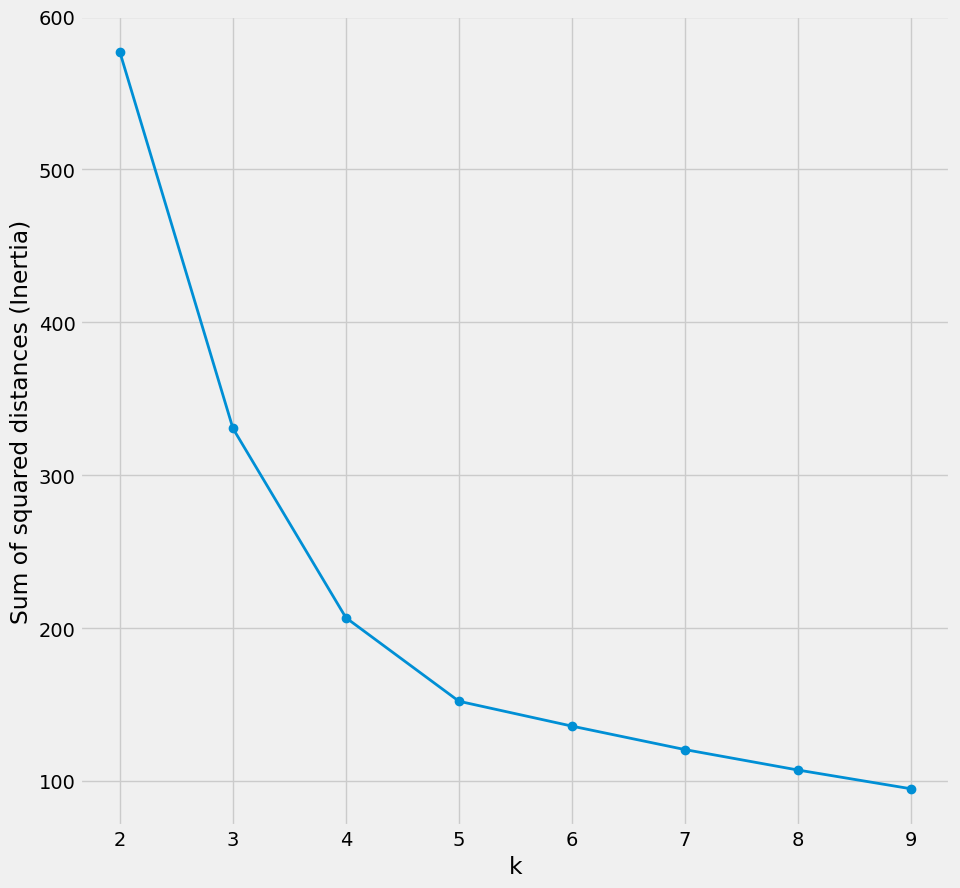

In [73]:
plt.figure(figsize=(10, 10))
plt.plot(k_values, inertias, marker='o')
plt.xlabel("k")
plt.ylabel("Sum of squared distances (Inertia)")

plt.grid(True)
plt.show()

In [74]:
kmeans = KMeans(n_clusters=5, random_state=0, n_init=20)
subset = df_cluster[cluster_columns]
df_cluster["cluster"] = kmeans.fit_predict(subset)

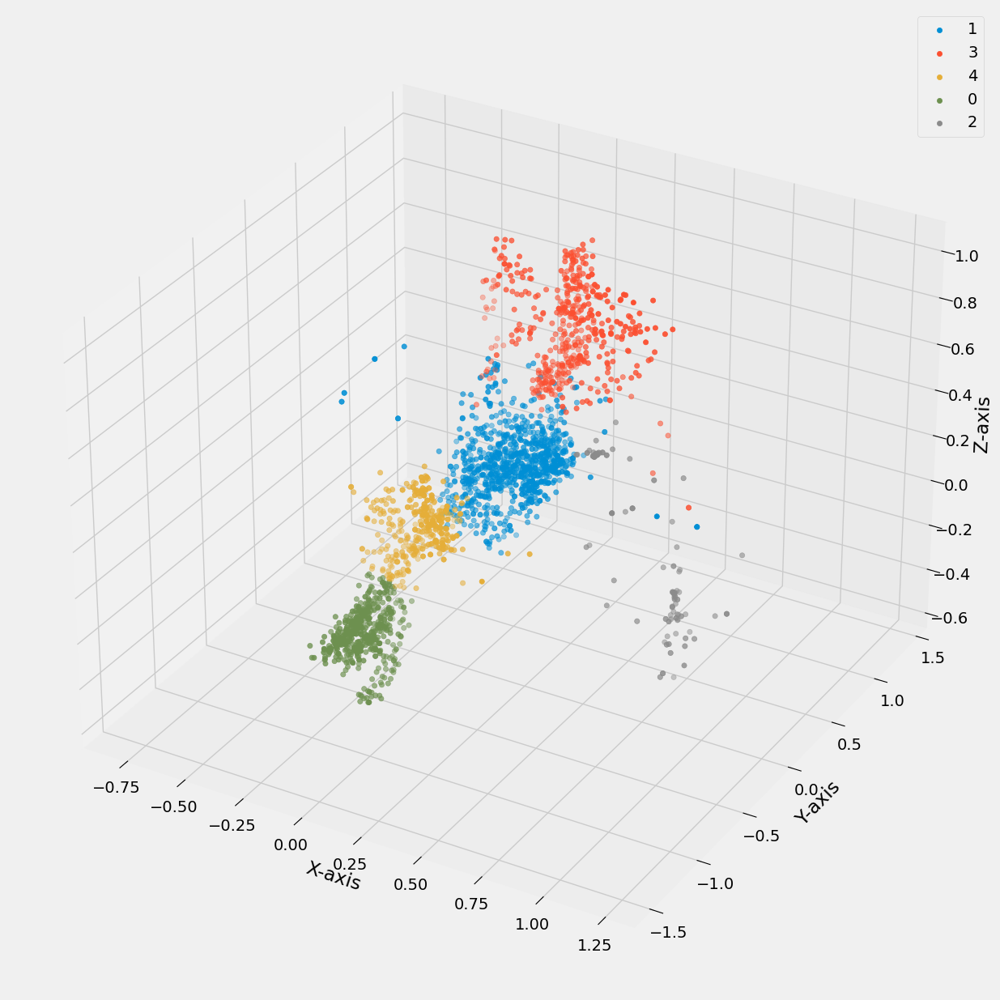

In [75]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D  # Ensure 3D plotting is supported

fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(projection="3d")

for c in df_cluster["cluster"].unique():
    subset = df_cluster[df_cluster["cluster"] == c]
    ax.scatter(
        subset["acc_x"],
        subset["acc_y"],
        subset["acc_z"],
        label=c
    )

ax.set_xlabel("X-axis")
ax.set_ylabel("Y-axis")
ax.set_zlabel("Z-axis")
plt.legend()
plt.show()

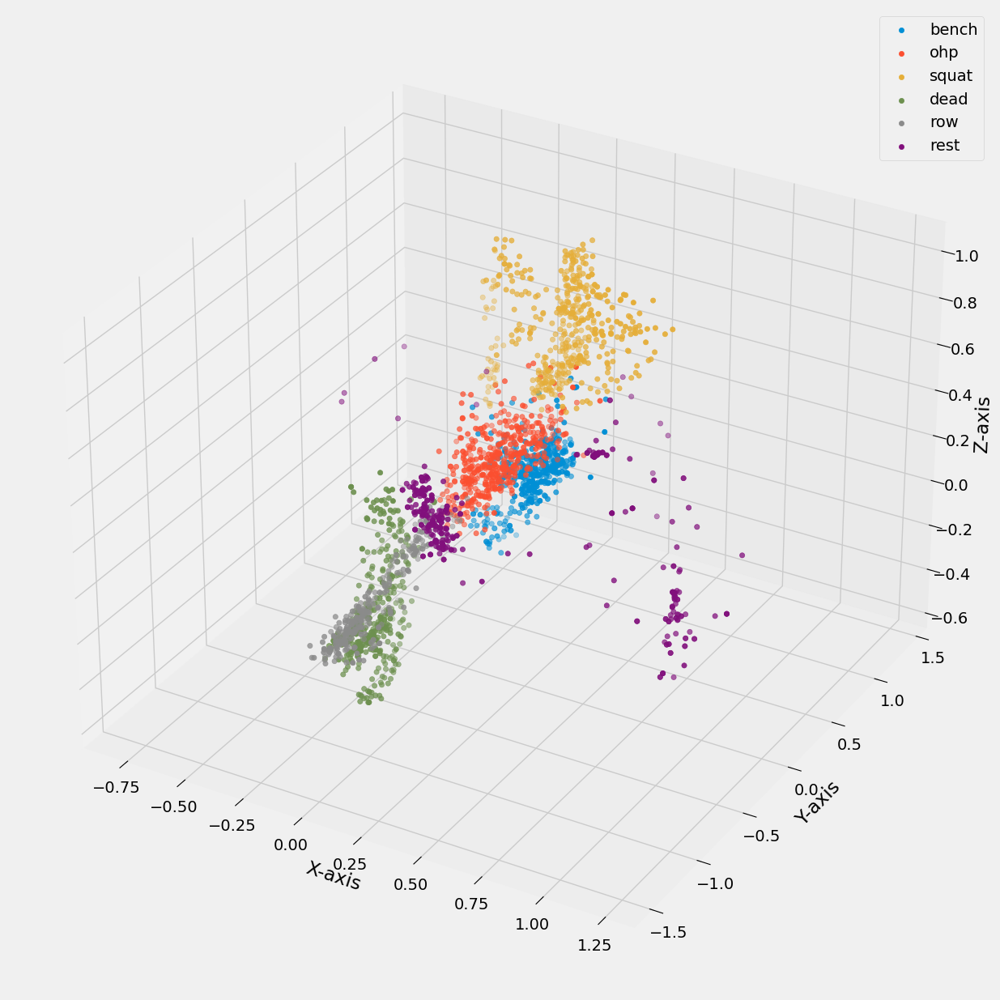

In [76]:
fig = plt.figure(figsize=(15, 15))
ax = fig.add_subplot(projection="3d")

for c in df_cluster["label"].unique():
    subset = df_cluster[df_cluster["label"] == c]
    ax.scatter(
        subset["acc_x"],
        subset["acc_y"],
        subset["acc_z"],
        label=c
    )

ax.set_xlabel("X-axis")
ax.set_ylabel("Y-axis")
ax.set_zlabel("Z-axis")
plt.legend()
plt.show()

In [77]:
df_cluster.pickle("../../data/interim/03_data_features.pkl")

AttributeError: 'DataFrame' object has no attribute 'pickle'

In [78]:
df_cluster.to_pickle("../../data/interim/03_data_features.pkl")